Please run those two cells before running the Notebook!

As those plotting settings are standard throughout the book, we do not show them in the book every time we plot something.

In [1]:
%matplotlib inline
%config InlineBackend.figure_format = "retina"

In [3]:
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
from pandas.errors import SettingWithCopyWarning
warnings.simplefilter(action="ignore", category=FutureWarning)
warnings.simplefilter(action="ignore", category=SettingWithCopyWarning)

# feel free to modify, for example, change the context to "notebook"
sns.set_theme(context="talk", style="whitegrid", 
              palette="colorblind", color_codes=True, 
              rc={"figure.figsize": [12, 8]})

# Chapter 13 - Applied Machine Learning: Identifying Credit Default

각 개인이 신용카드/대출 사용한 것을 제대로 지불할 지 여부를 판단하는 것을 머신 러닝으로 해결해 본다.

사용하는 데이터
- UCI Machine Learning Repository에 올라온 데이터를 사용
- 2005년 10월 대만 은행에서 수집된 데이터
- 해당 시기는 신용카드/대출이 늘면서 점점 지불 불이행이 늘고 있는 상황

다음의 정보를 가지고 고객이 2005년 10월에 지불을 불이행할 지를 예측하고자 한다.
- 고객의 기본정보
  - 성별, 연령, 교육 수준
- 과거 5개월의 상환 이력 (2005년 4월~9월)
- 기타 (신용 최대치)

이 장에서는 머신 러닝을 하기 위해서 필요한 작업들을 다양하기 수행해 본다.
- 데이터 수집 및 정리
- Classifier(분류기) 만들기
- Classifier 튜닝하기

다음과 같은 순서로 진행
- 데이터 읽어오기 & 데이터 타입 관리
- 데이터를 살펴보기
- 학습 데이터와 테스트 데이터 분할
- 결측값 확인 및 처리
- Category 값을 숫자로 인코딩
- Classifier를 만들고 최적화 하기
- 전체 과정을 Pipeline으로 만들기
- 그리드 검색과 Cross-Validation을 이용하여 Hyper-parameter를 튜닝하기

## 13.0 Getting and preparing the data

데이터 다운로드 링크
[UC Irvine Machine Learning Repository](https://archive.ics.uci.edu/ml/datasets/default+of+credit+card+clients).

- 원본 데이터는 결측값이 없고 Category값으 모두 숫자로 인코딩 되어 있다.
- 예시로 과정을 보여주기 위해서 Category값을 문자열로 바꾸고, 결측값(0.5%)을 추가했다.
- 일부 값은 Others 또는 Unknown으로 변경

In [4]:
import pandas as pd
import numpy as np
import random

In [4]:
# downloading the data 
!wget https://archive.ics.uci.edu/ml/machine-learning-databases/00350/default%20of%20credit%20card%20clients.xls

'wget'은(는) 내부 또는 외부 명령, 실행할 수 있는 프로그램, 또는
배치 파일이 아닙니다.


In [7]:
# load the data from Excel
df = pd.read_excel("default of credit card clients.xls", skiprows=1, index_col=0)

# rename columns
df.columns = df.columns.str.lower().str.replace(" ", "_")

months = ["sep", "aug", "jul", "jun", "may", "apr"]
variables = ["payment_status", "bill_statement", "previous_payment"]
new_column_names = [x + "_" + y for x in variables for y in months]
rename_dict = {x: y for x, y in zip(df.loc[:, "pay_0":"pay_amt6"].columns, new_column_names)}
df.rename(columns=rename_dict, inplace=True)


# create dicts to map number to strings
gender_dict = {1: "Male", 
               2: "Female"}
education_dict = {0: "Others",
                  1: "Graduate school", 
                  2: "University", 
                  3: "High school", 
                  4: "Others",
                  5: "Others",
                  6: "Others"}
marital_status_dict = {0: "Others", 
                       1: "Married", 
                       2: "Single", 
                       3: "Others"}
payment_status = {-2: "Unknown",
                  -1: "Payed duly",
                  0: "Unknown",
                  1: "Payment delayed 1 month",
                  2: "Payment delayed 2 months",
                  3: "Payment delayed 3 months",
                  4: "Payment delayed 4 months",
                  5: "Payment delayed 5 months",
                  6: "Payment delayed 6 months",
                  7: "Payment delayed 7 months",
                  8: "Payment delayed 8 months",
                  9: "Payment delayed >= 9 months"}

# map numbers to strings
df["sex"] = df["sex"].map(gender_dict)
df["education"] = df["education"].map(education_dict)
df["marriage"] = df["marriage"].map(marital_status_dict)

for column in [x for x in df.columns if ("status" in x)]:
    df[column] = df[column].map(payment_status)

# define the ratio of missing values
RATIO_MISSING = 0.005

# input missing values to selected columns
random_state = np.random.RandomState(42)
for column in ["sex", "education", "marriage", "age"]:
    df.loc[df.sample(frac=RATIO_MISSING, random_state=random_state).index, column] = ""

# reset index
df.reset_index(drop=True, inplace=True)

# save to csv
df.to_csv("../credit_card_default.csv", index=False)

## 13.1 Loading data and managing data types

In [ ]:
데이터 로딩은 CSV 파일을 Pandas를 이용해서 로딩
- Json, XML, Excel, Parquet, Feather 등을 사용 가능
- pd.read_xxx 형태로 일관된 API

추가로 메모리를 절약하기 위해서 여러 가지 방법을 설명

### How to do it...

1. Import the libraries:

In [5]:
import pandas as pd

2. Load the data from the CSV file:

In [6]:
df = pd.read_csv("../credit_card_default.csv", 
                 na_values="")
df

,limit_bal,sex,education,marriage,age,payment_status_sep,payment_status_aug,payment_status_jul,payment_status_jun,payment_status_may,...,bill_statement_jun,bill_statement_may,bill_statement_apr,previous_payment_sep,previous_payment_aug,previous_payment_jul,previous_payment_jun,previous_payment_may,previous_payment_apr,default_payment_next_month
0,20000,Female,University,Married,24.0,Payment delayed 2 months,Payment delayed 2 months,Payed duly,Payed duly,Unknown,...,0,0,0,0,689,0,0,0,0,1
1,120000,Female,University,Single,26.0,Payed duly,Payment delayed 2 months,Unknown,Unknown,Unknown,...,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,90000,Female,University,Single,34.0,Unknown,Unknown,Unknown,Unknown,Unknown,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,50000,Female,University,Married,37.0,Unknown,Unknown,Unknown,Unknown,Unknown,...,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,50000,Male,University,Married,57.0,Payed duly,Unknown,Payed duly,Unknown,Unknown,...,20940,19146,19131,2000,36681,10000,9000,689,679,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,220000,NaN,High school,Married,39.0,Unknown,Unknown,Unknown,Unknown,Unknown,...,88004,31237,15980,8500,20000,5003,3047,5000,1000,0
29996,150000,Male,High school,Single,43.0,Payed duly,Payed duly,Payed duly,Payed duly,Unknown,...,8979,5190,0,1837,3526,8998,129,0,0,0
29997,30000,Male,University,Single,37.0,Payment delayed 4 months,Payment delayed 3 months,Payment delayed 2 months,Payed duly,Unknown,...,20878,20582,19357,0,0,22000,4200,2000,3100,1
29998,80000,Male,High school,Married,41.0,Payment delayed 1 month,Payed duly,Unknown,Unknown,Unknown,...,52774,11855,48944,85900,3409,1178,1926,52964,1804,1


3. View the summary of the DataFrame:

데이터 설명
- limit_bal: 신용 한도 (대만 달러 - 43 원/대만달러)
- sex: 성별
- education: 교육수준
- marriage: 결혼 상태
- age: 나이
- payment_status_(month) - 지난 6개월 동안의 지불 상태 (월별)
- bill_statement_(month) - 지난 6개월 동안의 청구서 금액
- previous_payment_(month) - 지난 6개월 동안의 지불 금액
- default_payment_next_month - 다음 달(10월)에 고객이 지불을 불이행 했는지 여부

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 24 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   limit_bal                   30000 non-null  int64  
 1   sex                         29850 non-null  object 
 2   education                   29850 non-null  object 
 3   marriage                    29850 non-null  object 
 4   age                         29850 non-null  float64
 5   payment_status_sep          30000 non-null  object 
 6   payment_status_aug          30000 non-null  object 
 7   payment_status_jul          30000 non-null  object 
 8   payment_status_jun          30000 non-null  object 
 9   payment_status_may          30000 non-null  object 
 10  payment_status_apr          30000 non-null  object 
 11  bill_statement_sep          30000 non-null  int64  
 12  bill_statement_aug          30000 non-null  int64  
 13  bill_statement_jul          300

4. Define a function for inspecting the exact memory usage of a DataFrame:

메모리 사용량을 측정할 때에 deep=True를 사용하는 이유
- python의 object는 실제 데이터(문자열)로의 연결임
- deep=True로 해야 해당 연결을 따라가서 연결 가능한 모든 메모리를 계산함

In [8]:
def get_df_memory_usage(df, top_columns=5):
    """
    Function for quick analysis of a pandas DataFrame's memory usage.
    It prints the top `top_columns` columns in terms of memory usage 
    and the total usage of the DataFrame.
    
    Parameters
    ------------
    df : pd.DataFrame
        DataFrame to be inspected
    top_columns : int
        Number of top columns (in terms of memory used) to display
    """
    print("Memory usage ----")
    memory_per_column = df.memory_usage(deep=True) / (1024 ** 2)
    print(f"Top {top_columns} columns by memory (MB):")
    print(memory_per_column.sort_values(ascending=False) \
                           .head(top_columns))
    print(f"Total size: {memory_per_column.sum():.2f} MB")

In [9]:
get_df_memory_usage(df, 5)

Memory usage ----
Top 5 columns by memory (MB):
education             1.965001
payment_status_sep    1.954342
payment_status_aug    1.920288
payment_status_jul    1.916343
payment_status_jun    1.904229
dtype: float64
Total size: 20.47 MB


5. Convert the columns with `object` data type into `category` type:

- 문자열을 Pandas의 category 타입을 사용해서 메모리를 줄인다.
- category 타입으로 변환하면 문자열에서 중복 제거한 목록을 뽑아서 사전을 만들어 저장한 후에 해당 사전의 Index 값을 대신 사용한다.

In [10]:
object_columns = df.select_dtypes(include="object").columns
df[object_columns] = df[object_columns].astype("category")

get_df_memory_usage(df)

Memory usage ----
Top 5 columns by memory (MB):
bill_statement_sep      0.228882
bill_statement_aug      0.228882
previous_payment_apr    0.228882
previous_payment_may    0.228882
previous_payment_jun    0.228882
dtype: float64
Total size: 3.70 MB


6. Downcast the numeric columns to integers:

- 숫자들이 float64(8bytes)를 사용하는데 이를 integer로 변경
- integer 중에서 적절한 크기의 형식으로 자동 변경
- int32(4bytes)와 int8(1byte)를 사용

In [11]:
numeric_columns = df.select_dtypes(include="number").columns
for col in numeric_columns:
    df[col] = pd.to_numeric(df[col], downcast="integer")

get_df_memory_usage(df)

Memory usage ----
Top 5 columns by memory (MB):
age                     0.228882
bill_statement_sep      0.114441
limit_bal               0.114441
previous_payment_jun    0.114441
previous_payment_jul    0.114441
dtype: float64
Total size: 2.01 MB


In [12]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 24 columns):
 #   Column                      Non-Null Count  Dtype   
---  ------                      --------------  -----   
 0   limit_bal                   30000 non-null  int32   
 1   sex                         29850 non-null  category
 2   education                   29850 non-null  category
 3   marriage                    29850 non-null  category
 4   age                         29850 non-null  float64 
 5   payment_status_sep          30000 non-null  category
 6   payment_status_aug          30000 non-null  category
 7   payment_status_jul          30000 non-null  category
 8   payment_status_jun          30000 non-null  category
 9   payment_status_may          30000 non-null  category
 10  payment_status_apr          30000 non-null  category
 11  bill_statement_sep          30000 non-null  int32   
 12  bill_statement_aug          30000 non-null  int32   
 13  bill_statement_j

7. Downcast the `age` column using the `float` data type:

- 나이는 별도로 float로 변경

In [13]:
df["age"] = pd.to_numeric(df["age"], downcast="float")

get_df_memory_usage(df)

Memory usage ----
Top 5 columns by memory (MB):
bill_statement_sep      0.114441
limit_bal               0.114441
previous_payment_jun    0.114441
previous_payment_jul    0.114441
previous_payment_aug    0.114441
dtype: float64
Total size: 1.90 MB


### There's more

머신 러닝의 경우 데이터의 크기가 커서 메모리에 모두 로딩하기 어려운 경우가 많다.
이럴 때는 다음과 같은 방법을 사용할 수 있다.

- 데이터를 일부만 읽어서 처리한다. (read_csv의 chunksize 사용)
- 필요한 열만 읽는다 (read_csv의 usecols 사용)
- 데이터를 로딩할 때 미리 변환할 타입을 지정한다 (read_csv의 dtype 사용)

이런 방법으로도 해결이 안되면 대용량 데이터용 라이브러리를 사용한다.

- Dask: 분산 컴퓨팅용 라이브러리. 데이터 처리 작업을 나누어서 numpy또는 pandas가 처리하고 결과를 조립
- Modin: pandas DataFrame을 CPU 코어에 나누어 처리
- Vaex: 대용량 외부 메모리 DataFrame을 사용할 수 있는 라이브러리
- datatable: 2차원 표를 다룰 수 있는 pandas와 유사하지만 속도/메모리 효율이 좋은 라이브러리
- cuDF: Nvidia의 GPU를 활용할 수 있는 DataFrame 라이브러리
- polars: Apache Arrow 메모리 모델과 Rust 언어를 활용하는 DataFrame 라이브러리

Assign the data types to columns while loading the data using the `pd.read_csv`` method.

In [14]:
column_dtypes = {
    "education": "category", 
    "marriage": "category", 
    "sex": "category"
}
df_cat = pd.read_csv("../credit_card_default.csv", 
                     na_values="", dtype=column_dtypes)

get_df_memory_usage(df_cat)

Memory usage ----
Top 5 columns by memory (MB):
payment_status_sep    1.954342
payment_status_aug    1.920288
payment_status_jul    1.916343
payment_status_jun    1.904229
payment_status_apr    1.897395
dtype: float64
Total size: 15.01 MB


## 13.2 Exploratory data analysis

데이터를 사용하기 전에 조사해 보는 여러 가지 방법에 대해서 설명

가능한 여러 분석들
- 어떤 종류의 데이터이고 형식을 어떻게 처리해야 하나?
- 분포는 어떤가?
- 이상치는 어떤가?
- 변환을 해야하나?
- 그룹 별로 분포가 다른가?
- 결측치가 있나? 결측치의 특징은?
- 데이터 간에 상관관계가 있나?
- 기존 데이터에서 생성할 파생 데이터가 있나?
- 필요없는 데이터는 없나?

### Getting ready

In [15]:
import pandas as pd
df = pd.read_csv("../credit_card_default.csv", na_values="")

### How to do it...

1. Import the libraries:

In [16]:
import pandas as pd
import numpy as np
import seaborn as sns
import plotly.express as px
import plotly.io as pio

2. Get summary statistics of the numeric variables: 

In [17]:
df.describe().transpose().round(2)

,count,mean,std,min,25%,50%,75%,max
limit_bal,30000.0,167484.32,129747.66,10000.0,50000.00,140000.0,240000.00,1000000.0
age,29850.0,35.49,9.22,21.0,28.00,34.0,41.00,79.0
bill_statement_sep,30000.0,51223.33,73635.86,-165580.0,3558.75,22381.5,67091.00,964511.0
bill_statement_aug,30000.0,49179.08,71173.77,-69777.0,2984.75,21200.0,64006.25,983931.0
bill_statement_jul,30000.0,47013.15,69349.39,-157264.0,2666.25,20088.5,60164.75,1664089.0
bill_statement_jun,30000.0,43262.95,64332.86,-170000.0,2326.75,19052.0,54506.00,891586.0
bill_statement_may,30000.0,40311.40,60797.16,-81334.0,1763.00,18104.5,50190.50,927171.0
bill_statement_apr,30000.0,38871.76,59554.11,-339603.0,1256.00,17071.0,49198.25,961664.0
previous_payment_sep,30000.0,5663.58,16563.28,0.0,1000.00,2100.0,5006.00,873552.0
previous_payment_aug,30000.0,5921.16,23040.87,0.0,833.00,2009.0,5000.00,1684259.0


3. Get summary statistics of the categorical variables: 

In [18]:
df.describe(include="object").transpose()

,count,unique,top,freq
sex,29850,2,Female,18027
education,29850,4,University,13960
marriage,29850,3,Single,15891
payment_status_sep,30000,10,Unknown,17496
payment_status_aug,30000,10,Unknown,19512
payment_status_jul,30000,10,Unknown,19849
payment_status_jun,30000,10,Unknown,20803
payment_status_may,30000,9,Unknown,21493
payment_status_apr,30000,9,Unknown,21181


Alternatively, we can get the summary statistics of all columns in one table using the following snippet:

In [19]:
df.describe(include="all").transpose()

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
limit_bal,30000.0,NaN,NaN,NaN,167484.322667,129747.661567,10000.0,50000.0,140000.0,240000.0,1000000.0
sex,29850,2,Female,18027,NaN,NaN,NaN,NaN,NaN,NaN,NaN
education,29850,4,University,13960,NaN,NaN,NaN,NaN,NaN,NaN,NaN
marriage,29850,3,Single,15891,NaN,NaN,NaN,NaN,NaN,NaN,NaN
age,29850.0,NaN,NaN,NaN,35.490117,9.217852,21.0,28.0,34.0,41.0,79.0
payment_status_sep,30000,10,Unknown,17496,NaN,NaN,NaN,NaN,NaN,NaN,NaN
payment_status_aug,30000,10,Unknown,19512,NaN,NaN,NaN,NaN,NaN,NaN,NaN
payment_status_jul,30000,10,Unknown,19849,NaN,NaN,NaN,NaN,NaN,NaN,NaN
payment_status_jun,30000,10,Unknown,20803,NaN,NaN,NaN,NaN,NaN,NaN,NaN
payment_status_may,30000,9,Unknown,21493,NaN,NaN,NaN,NaN,NaN,NaN,NaN


4. Plot the distribution of age and, additionally, split it by gender:

- common_norm을 이용해서 그룹을 합쳐서 normalize하거나 그룹별로 normalize할 수 있다.

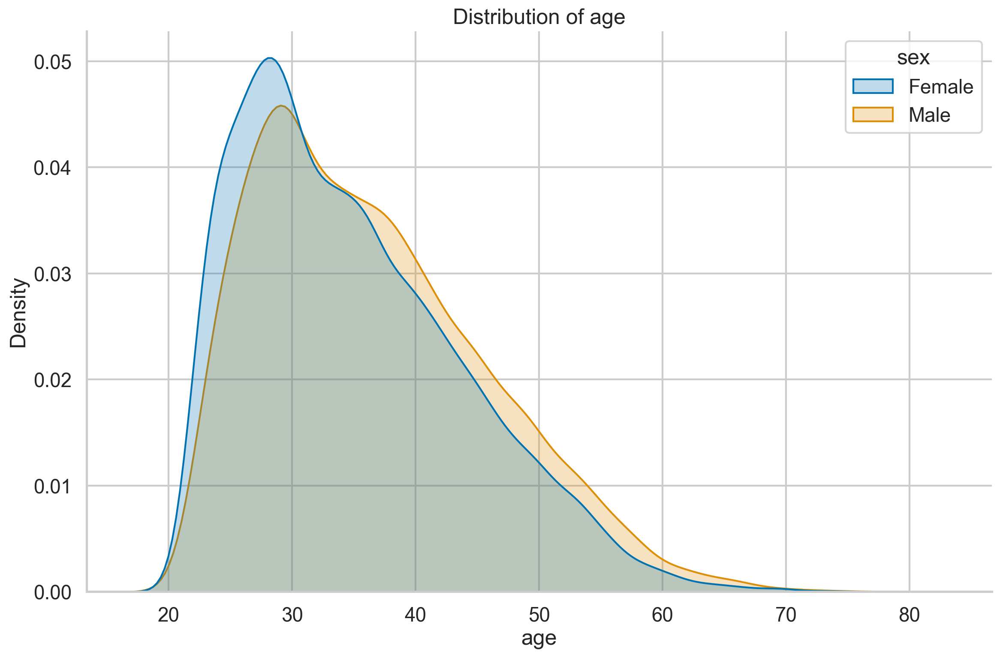

In [20]:
ax = sns.kdeplot(data=df, x="age", 
                 hue="sex", common_norm=False, 
                 fill=True)
ax.set_title("Distribution of age")

sns.despine()
plt.tight_layout()
# plt.savefig("images/figure_13_1", dpi=200)

As mentioned in the text, we can create a histogram (together with the KDE), by running:

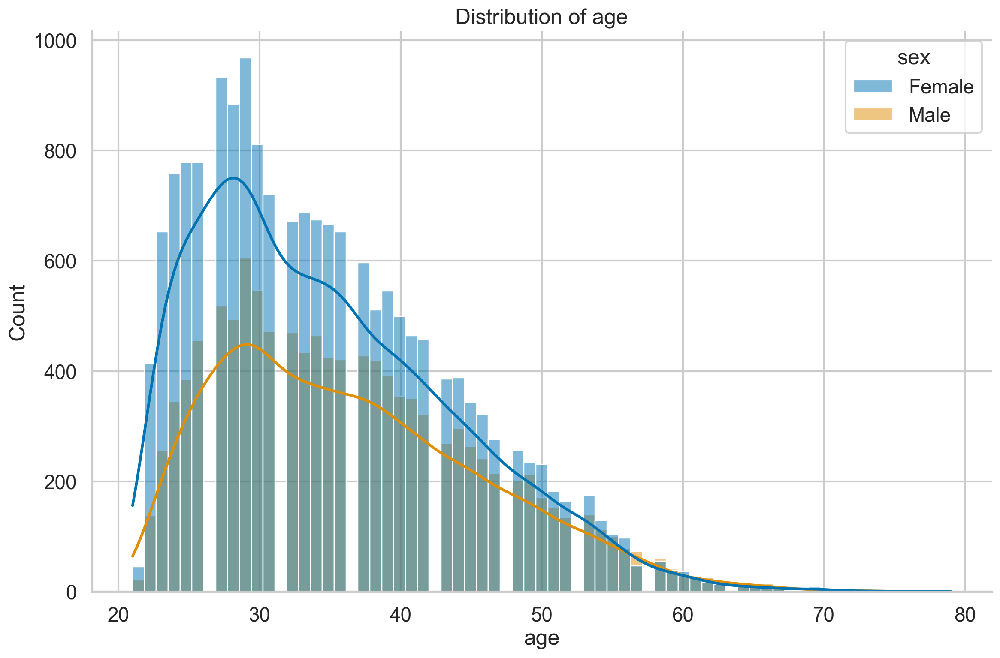

In [27]:
ax = sns.histplot(data=df.dropna(), x="age", hue="sex", kde=True)
ax.set_title("Distribution of age");

sns.despine()
plt.tight_layout()

We noticed some gaps in the plot and the reason for this is the binning. Below, we created the same histogram using `sns.countplot` and `plotly_express`. By doing so, each value of age has a separate bin and we can inspect the plot in detail. There are no such spikes in the following plots:

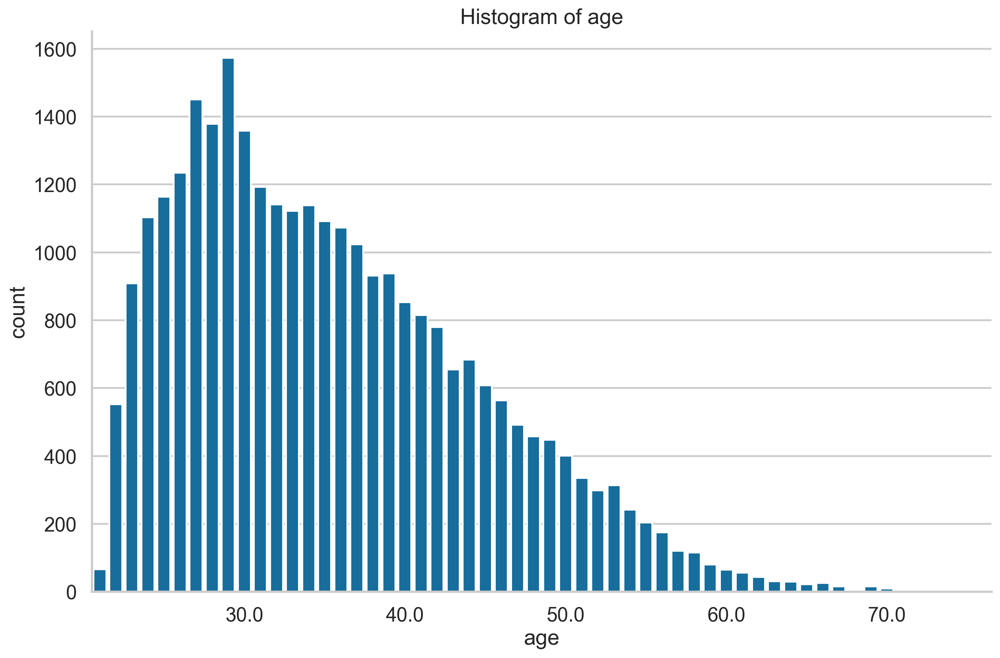

In [28]:
ax = sns.countplot(data=df.dropna(), x="age", color="b")

for ind, label in enumerate(ax.get_xticklabels()):
    if int(float(label.get_text())) % 10 == 0:
        label.set_visible(True)
    else:
        label.set_visible(False)

ax.set_title("Histogram of age")

sns.despine()
plt.tight_layout()

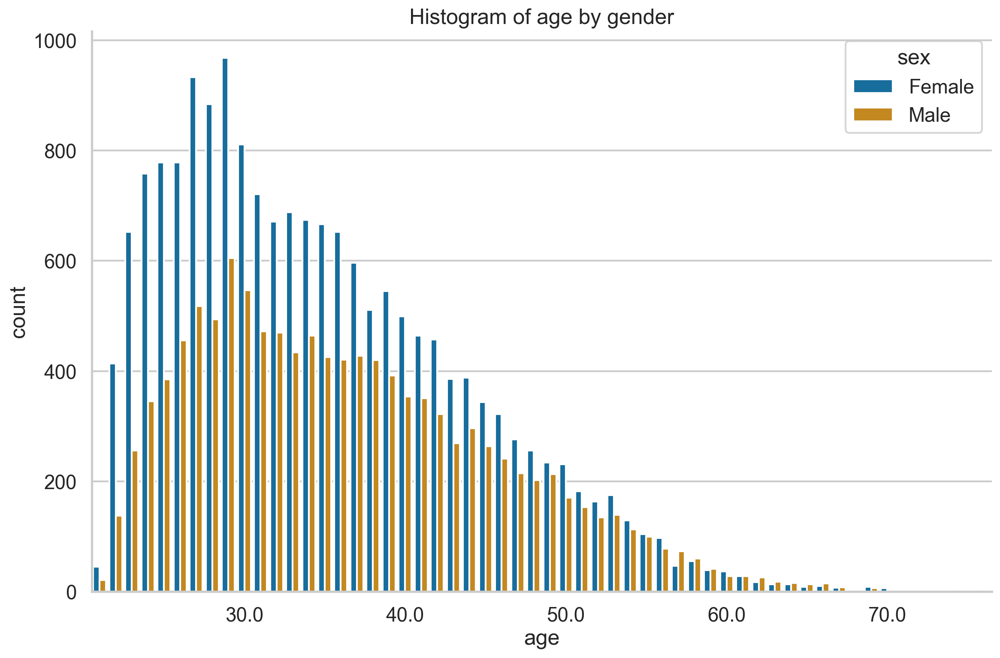

In [29]:
ax = sns.countplot(data=df.dropna(), x="age", hue="sex")

for ind, label in enumerate(ax.get_xticklabels()):
    if int(float(label.get_text())) % 10 == 0:
        label.set_visible(True)
    else:
        label.set_visible(False)

ax.set_title("Histogram of age by gender")

sns.despine()
plt.tight_layout()

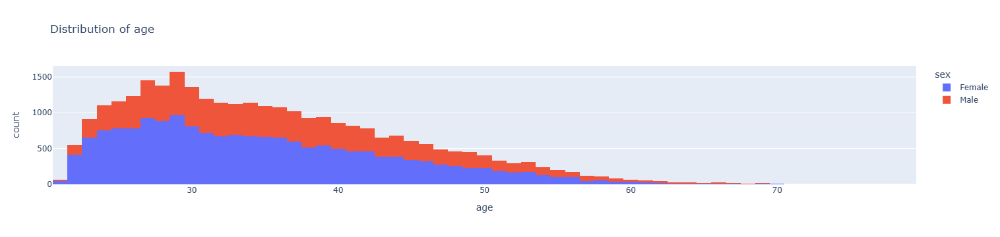

In [32]:
px.histogram(df.dropna(), x="age", color="sex", title = "Distribution of age")

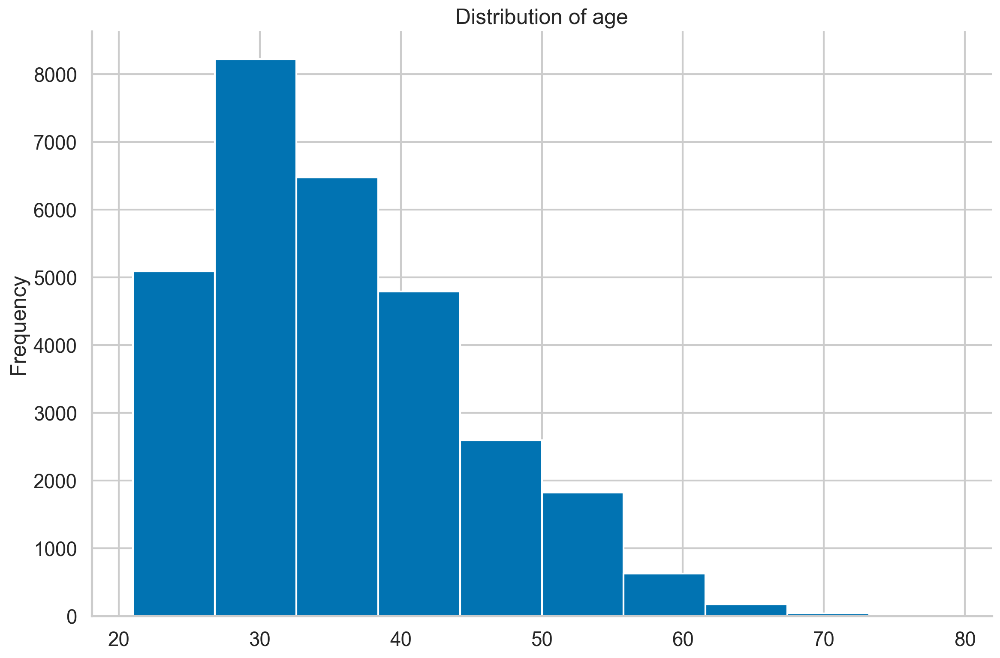

In [33]:
df["age"].plot(kind="hist", title="Distribution of age")

sns.despine()
plt.tight_layout()

5. Create a `pairplot` of selected variables:

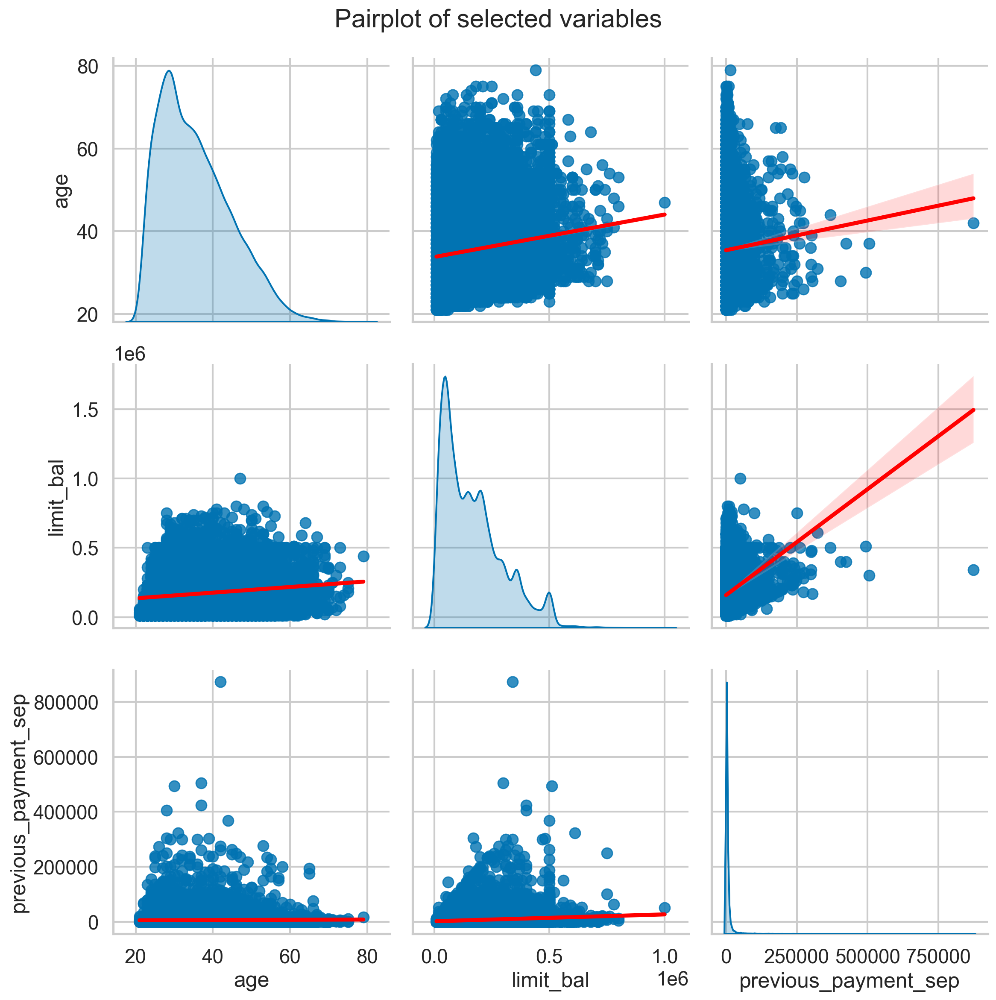

In [34]:
COLS_TO_PLOT = ["age", "limit_bal", "previous_payment_sep"]

pair_plot = sns.pairplot(df[COLS_TO_PLOT], kind="reg", 
                         diag_kind="kde", height=4,
                         plot_kws={"line_kws":{"color":"red"}})
pair_plot.fig.suptitle("Pairplot of selected variables")

sns.despine()
plt.tight_layout()
# plt.savefig("images/figure_13_2", dpi=200)

Additionally, we can separate the genders by specifying the `hue` argument:

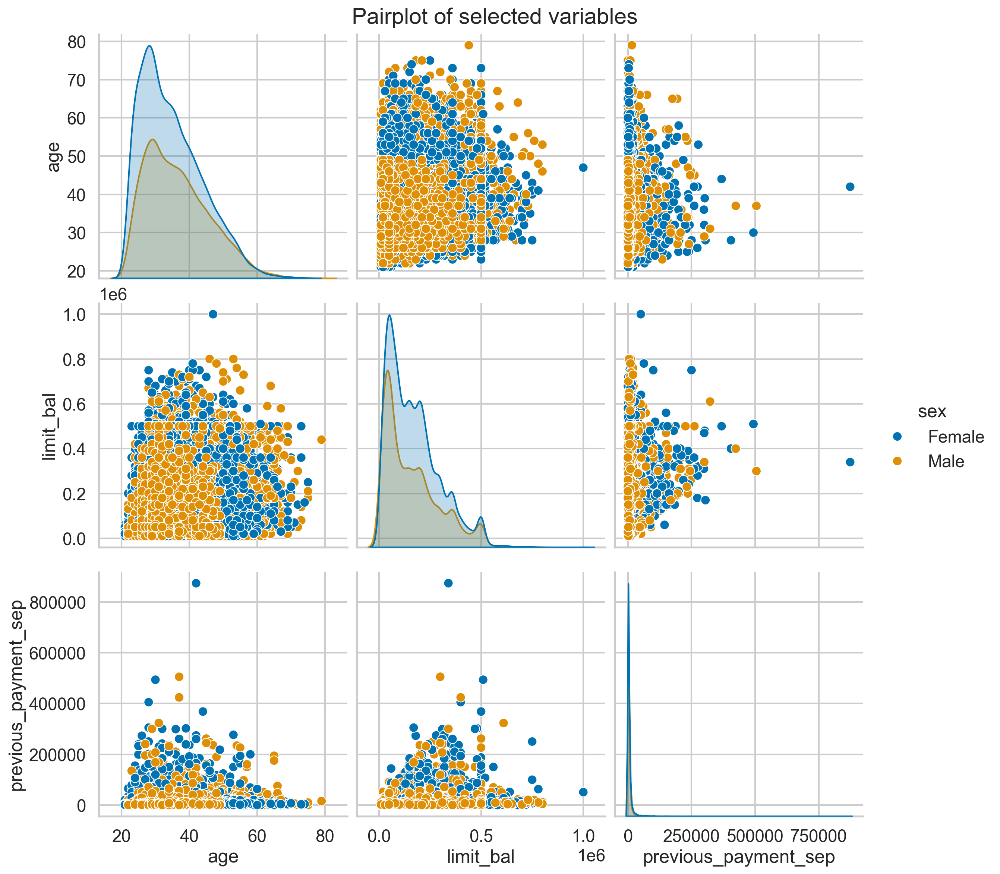

In [35]:
pair_plot = sns.pairplot(data=df, 
                         x_vars=COLS_TO_PLOT, 
                         y_vars=COLS_TO_PLOT, 
                         hue="sex", 
                         height=4)
pair_plot.fig.suptitle("Pairplot of selected variables")
plt.subplots_adjust(top=0.95)

# plt.savefig("images/figure_13_3", dpi=200)

6. Analyze the relationship between age and limit balance:

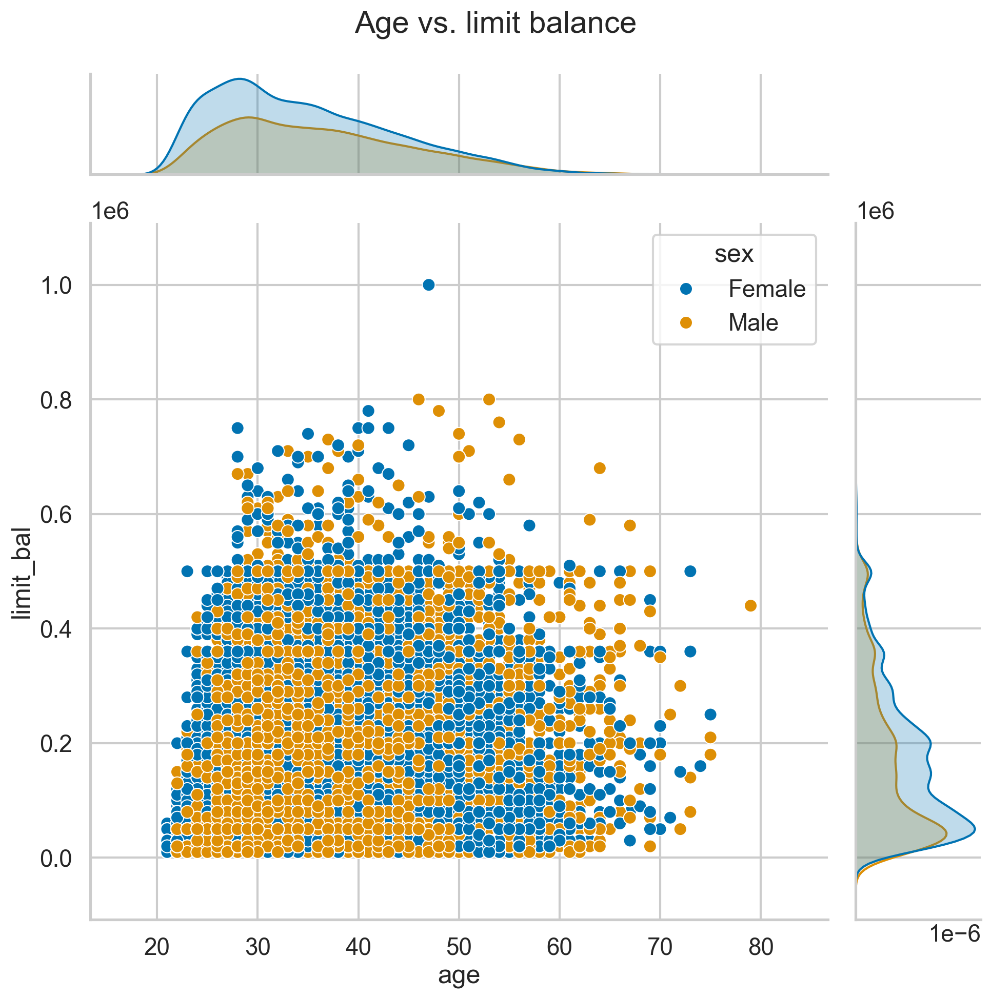

In [36]:
ax = sns.jointplot(data=df, x="age", y="limit_bal", 
                   hue="sex", height=10)
ax.fig.suptitle("Age vs. limit balance")

sns.despine()
plt.tight_layout()
# plt.savefig("images/figure_13_4", dpi=200)

7. Define and run a function for plotting the correlation heatmap:

- Mask를 사용해서 대각선 위 부분은 표시하지 않도록 처리

In [37]:
def plot_correlation_matrix(corr_mat, annotate=False):
    """
    Function for plotting the correlation heatmap. It masks the irrelevant fields.
    
    Parameters
    ----------
    corr_mat : pd.DataFrame
        Correlation matrix of the features.
    """
    
    # temporarily change style
    sns.set(style="white")
    # mask the upper triangle
    mask = np.zeros_like(corr_mat, dtype=bool)
    mask[np.triu_indices_from(mask)] = True
    # set up the matplotlib figure
    fig, ax = plt.subplots()
    # set up custom diverging colormap
    cmap = sns.diverging_palette(240, 10, n=9, as_cmap=True)
    # plot the heatmap
    sns.heatmap(corr_mat, mask=mask, cmap=cmap, 
                annot=annotate, vmax=.3, 
                center=0, square=True, linewidths=.5, 
                cbar_kws={"shrink": .5}, ax=ax)
    ax.set_title("Correlation Matrix", fontsize=16)
    # change back to darkgrid style
    sns.set(style="darkgrid")

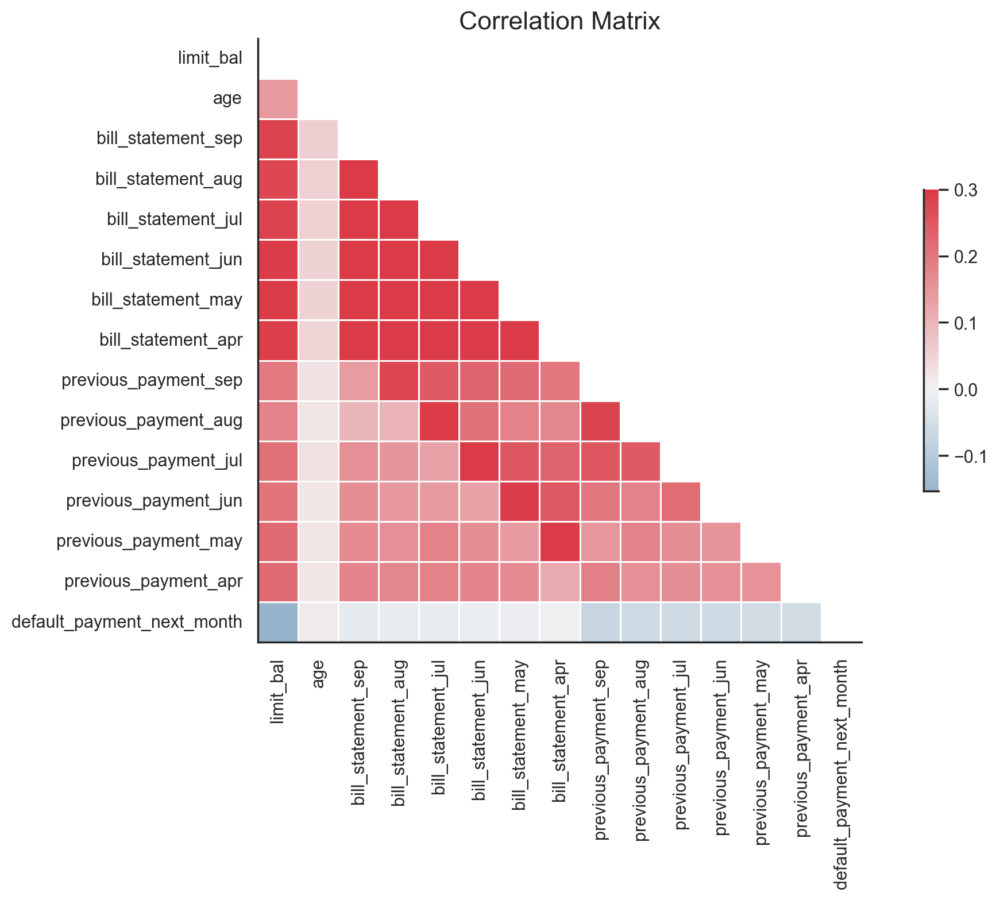

In [38]:
corr_mat = df.select_dtypes(include="number").corr()    
plot_correlation_matrix(corr_mat)

sns.despine()
plt.tight_layout()
# plt.savefig("images/figure_13_5", dpi=200)

We can also directly inspect the correlation between the features (numerical) and the target:

In [39]:
df.select_dtypes(include="number").corr()[["default_payment_next_month"]]

,default_payment_next_month
limit_bal,-0.153520
age,0.014491
bill_statement_sep,-0.019644
bill_statement_aug,-0.014193
bill_statement_jul,-0.014076
bill_statement_jun,-0.010156
bill_statement_may,-0.006760
bill_statement_apr,-0.005372
previous_payment_sep,-0.072929
previous_payment_aug,-0.058579


8. Analyze the distribution of age in groups using boxplots:

- 중앙값: 상자 안의 가로 검정 선
- 사분위 범위: 상자의 위(Q1)/아래(Q3)
- Whiskers: 상자에서 뻗어나온 선 (Q1 - 1.5IQR, Q3+1.5IQR)

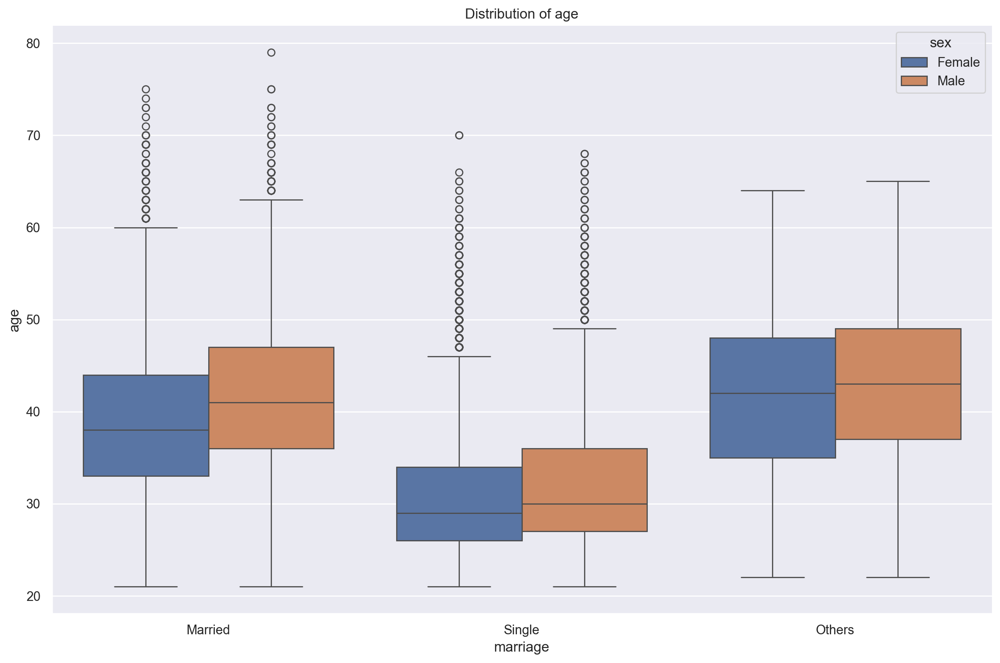

In [40]:
ax = sns.boxplot(data=df, y="age", x="marriage", hue="sex");
ax.set_title("Distribution of age")

sns.despine()
plt.tight_layout()
# plt.savefig("images/figure_13_6", dpi=200)

9. Plot the distribution of limit balance for each gender and education level:

- 중앙값: 흰 점
- 사분위 범위: 중심의 검은 막대
- 상위 하위 인접 값: 검은 막대에서 뻗어 나오는 선으로 표시 (Q1 - 1.5IQR, Q3 + 1.5IQR)

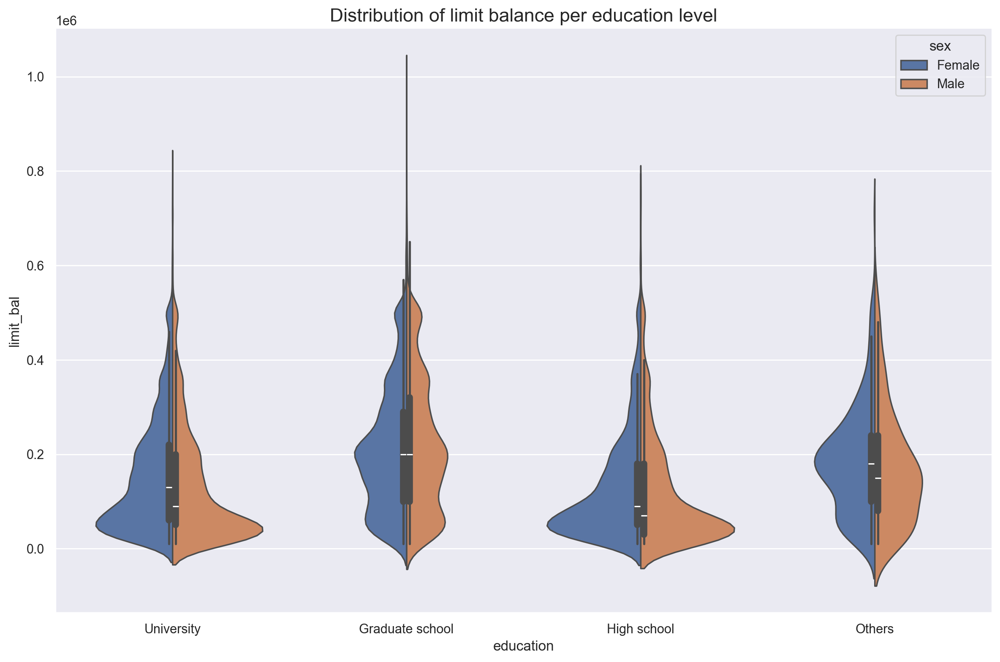

In [41]:
ax = sns.violinplot(x="education", y="limit_bal", 
                    hue="sex", split=True, data=df)
ax.set_title(
    "Distribution of limit balance per education level", 
    fontsize=16
)

sns.despine()
plt.tight_layout()
# plt.savefig("images/figure_13_7", dpi=200)

The following code plots the same information, without splitting the violin plots.

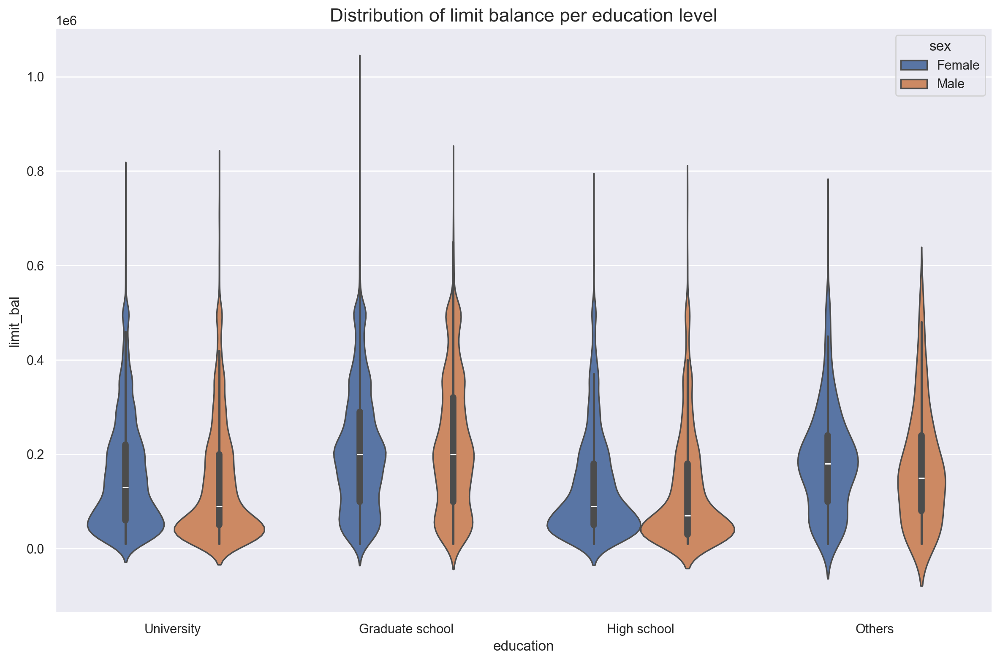

In [42]:
ax = sns.violinplot(x="education", y="limit_bal", 
                    hue="sex", data=df)
ax.set_title("Distribution of limit balance per education level", 
             fontsize=16)

sns.despine()
plt.tight_layout()

10. Investigate the distribution of the target variable per gender and education level:

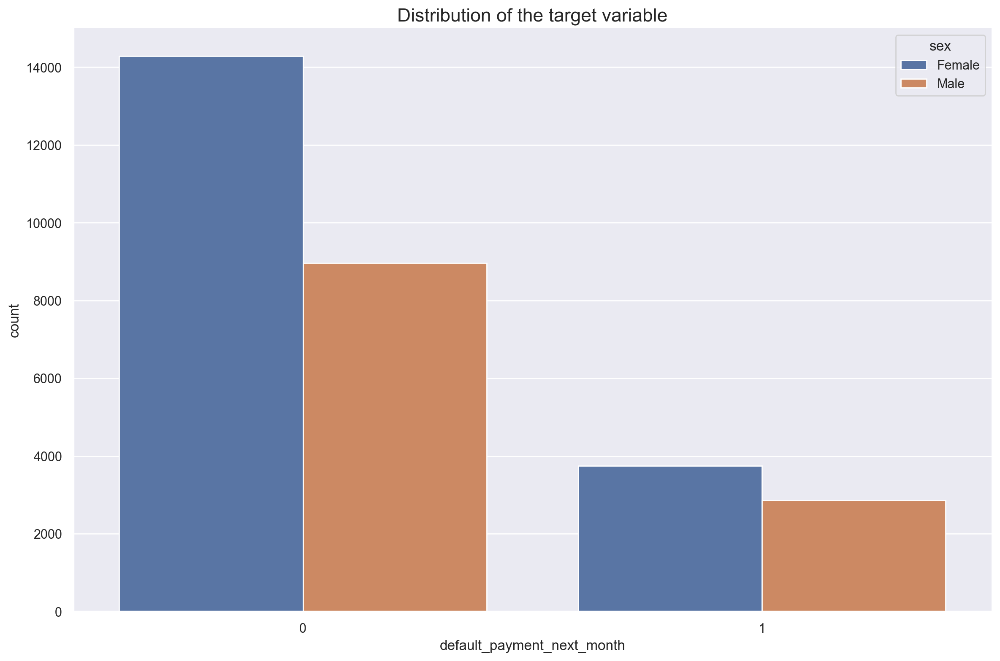

In [46]:
ax = sns.countplot(hue="sex", data=df, orient="h", x="default_payment_next_month")
ax.set_title("Distribution of the target variable", fontsize=16)

sns.despine()
plt.tight_layout()
# plt.savefig("images/figure_13_8", dpi=200)

11. Investigate the percentage of defaults per education level:

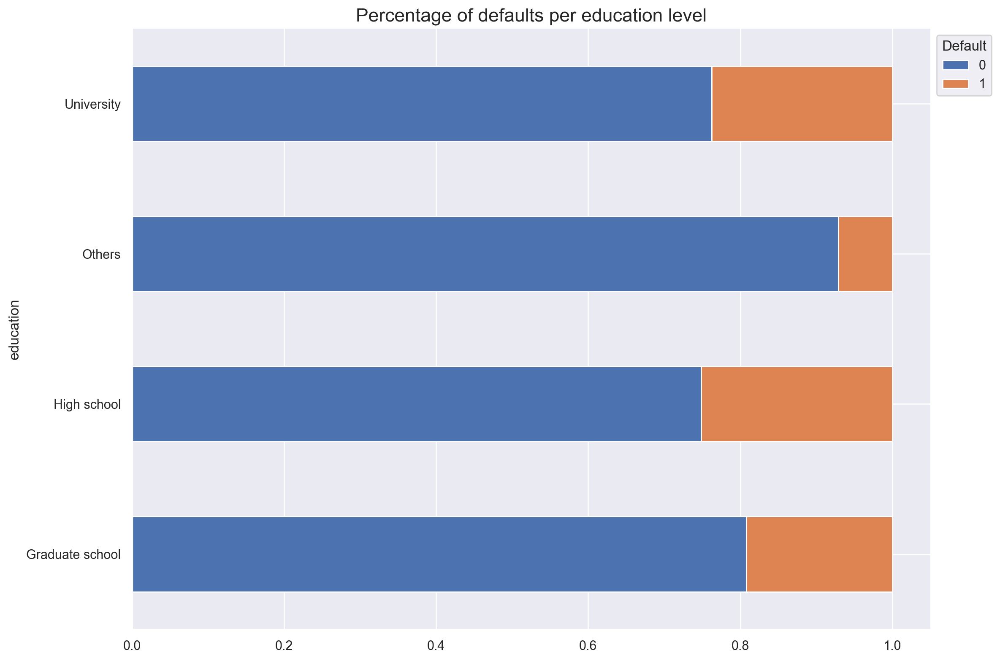

In [47]:
ax = df.groupby("education")["default_payment_next_month"] \
       .value_counts(normalize=True) \
       .unstack() \
       .plot(kind="barh", stacked=True)
ax.set_title("Percentage of defaults per education level", 
             fontsize=16)
ax.legend(title="Default", bbox_to_anchor=(1,1)) 

sns.despine()
plt.tight_layout()
# plt.savefig("images/figure_13_9", dpi=200)

### There's more

pandas_profiling을 이용하면 데이터 분석을 간단하게 할 수 있다.
- 분석한 전체 내용을 html 보고서로 생성함
- 이름이 ydata_profiling으로 변경되었음

In [22]:
from ydata_profiling import ProfileReport
profile = ProfileReport(df, title="Loan Default Dataset EDA")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [23]:
profile.to_file("loan_default_eda.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

## 13.3 Splitting the data into training and test sets

머신 러닝을 위해서는 데이터를 두개의 별도 세트로 분리
- Training 세트: 모델을 학습시키는데 사용하는 데이터
- Test 세트: 모델의 성능을 평가하는데 사용하는 데이터


분리하는 이유
- 데이터를 분리하는 이유는 모델이 데이터에 과적합될 경우 새로운 데이터에는 잘 적용되지 않음. 
- 이를 방지하기 위해서 Test 세트를 분리해서 모델의 평가를 한다
- 이때 Test 세트의 정보가 모델을 학습할 때에 조금이라도 들어가지 않도록 주의해야 한다.

### Getting ready

In [25]:
import pandas as pd
df = pd.read_csv("../credit_card_default.csv", na_values="")

### How to do it...

1. Import the libraries:

In [26]:
import pandas as pd
from sklearn.model_selection import train_test_split

2. Separate the target from the features:

In [27]:
X = df.copy()
y = X.pop("default_payment_next_month")

3. Split the data into training and test sets:

In [28]:
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

4. Split the data into training and test sets without shuffling:

In [29]:
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, shuffle=False
)

5. Split the data into training and test sets with stratification:

In [30]:
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, stratify=y, random_state=42
)

6. Verify that the ratio of the target is preserved:

In [31]:
print("Target distribution - train")
print(y_train.value_counts(normalize=True).values)
print("Target distribution - test")
print(y_test.value_counts(normalize=True).values)

Target distribution - train
[0.77879167 0.22120833]
Target distribution - test
[0.77883333 0.22116667]


### There's more

데이터 세트를 세 가지로 나누는 경우도 있다.
- 추가로 Validation 세트를 나눈다.
- Validation 세트는 모델의 형태와 같은 Hyper-parameter를 결정하기 위해서 사용한다.

In [32]:
import numpy as np

# define the size of the validation and test sets
VALID_SIZE = 0.1
TEST_SIZE = 0.2

# create the initial split - training and temp
X_train, X_temp, y_train, y_temp = train_test_split(
    X, y, 
    test_size=(VALID_SIZE + TEST_SIZE), 
    stratify=y, 
    random_state=42
)

# calculate the new test size
new_test_size = np.around(TEST_SIZE / (VALID_SIZE + TEST_SIZE), 2)

# create the valid and test sets
X_valid, X_test, y_valid, y_test = train_test_split(
    X_temp, y_temp, 
    test_size=new_test_size, 
    stratify=y_temp, 
    random_state=42
)

In [33]:
print("Percentage of data in each set ----")
print(f"Train: {100 * len(X_train) / len(X):.2f}%")
print(f"Valid: {100 * len(X_valid) / len(X):.2f}%")
print(f"Test: {100 * len(X_test) / len(X):.2f}%")
print("")
print("Class distribution in each set ----")
print(f"Train: {y_train.value_counts(normalize=True).values}")
print(f"Valid: {y_valid.value_counts(normalize=True).values}")
print(f"Test: {y_test.value_counts(normalize=True).values}")

Percentage of data in each set ----
Train: 70.00%
Valid: 9.90%
Test: 20.10%

Class distribution in each set ----
Train: [0.77879899 0.22120101]
Valid: [0.77878788 0.22121212]
Test: [0.77880948 0.22119052]


## 13.4 Identifying and dealing with missing values

결측치의 종류는 다음과 같다.
- 완전 무작위 결측치(MCAR): 결측값이 다른 데이터와 전혀 관련이 없는 경우
- 무작위 결측치(MAR): 결측값이 다른 데이터로부터 유추될 수 있는 경우
- 비무작위 결측치(MNAR): 결측값이 특정 이유에 의해서 발생하는 경우
- 구조적 결측치: 데이터의 특성에 따라 구조적으로 결측치가 될 수밖에 없는 경우

결측치를 처리하는 방법
- 결측값이 있는 행을 삭제
- 결측값이 많은 열을 삭제
- 결측값을 범위 밖 값으로 대체
- 시계열 데이터의 경우는 이전 값이나 이후 값으로 대체하거나 interpolation한다
- Hot-deck 기법: 상관관계가 높은 열을 골라서 해당 열로 정렬하고 결측값을 위/아래 값을 활용해서 채운다
- Aggregate metric으로 대체: 평균 또는 최빈값으로 대체
- 그룹별 Aggregate metric으로 대체: 그룹별 평균 또는 최빈값으로 대체
- 머신 러닝을 기반으로 결측값을 예측

결측치를 위한 머신러닝 기반 접근법

- MICE(Multiple Imputation by Chained Equations) 방법
  - https://stats.stackexchange.com/questions/421545/multiple-imputation-by-chained-equations-mice-explained
  - 결측값을 기본적으로 aggregate metric으로 대체
  - 결측값이 있던 열을 하나 골라서 다른 열의 데이터를 사용해서 회귀분석으로 결측값이었던 값을 개선
  - 이런 과정을 계속 반복
- kNN 대체 방법
  - k번째 까지 가까운 값을 찾아서 근사치를 구한다.
- MissForest 방법
  - 결측값을 기본적으로 aggregate metric으로 대체
  - 랜덤포레스트 모델을 사용해서 결측값을 예측해서 업데이트
  - 계속 반복

### How to do it...

1. Import the libraries:

In [35]:
import pandas as pd 
import missingno as msno
from sklearn.impute import SimpleImputer

2. Inspect the information about the DataFrame:

In [36]:
X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 23 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   limit_bal             30000 non-null  int64  
 1   sex                   29850 non-null  object 
 2   education             29850 non-null  object 
 3   marriage              29850 non-null  object 
 4   age                   29850 non-null  float64
 5   payment_status_sep    30000 non-null  object 
 6   payment_status_aug    30000 non-null  object 
 7   payment_status_jul    30000 non-null  object 
 8   payment_status_jun    30000 non-null  object 
 9   payment_status_may    30000 non-null  object 
 10  payment_status_apr    30000 non-null  object 
 11  bill_statement_sep    30000 non-null  int64  
 12  bill_statement_aug    30000 non-null  int64  
 13  bill_statement_jul    30000 non-null  int64  
 14  bill_statement_jun    30000 non-null  int64  
 15  bill_statement_may 

In [10]:
X.isnull().sum()

limit_bal                 0
sex                     150
education               150
marriage                150
age                     150
payment_status_sep        0
payment_status_aug        0
payment_status_jul        0
payment_status_jun        0
payment_status_may        0
payment_status_apr        0
bill_statement_sep        0
bill_statement_aug        0
bill_statement_jul        0
bill_statement_jun        0
bill_statement_may        0
bill_statement_apr        0
previous_payment_sep      0
previous_payment_aug      0
previous_payment_jul      0
previous_payment_jun      0
previous_payment_may      0
previous_payment_apr      0
dtype: int64

3. Visualize the nullity of the DataFrame:

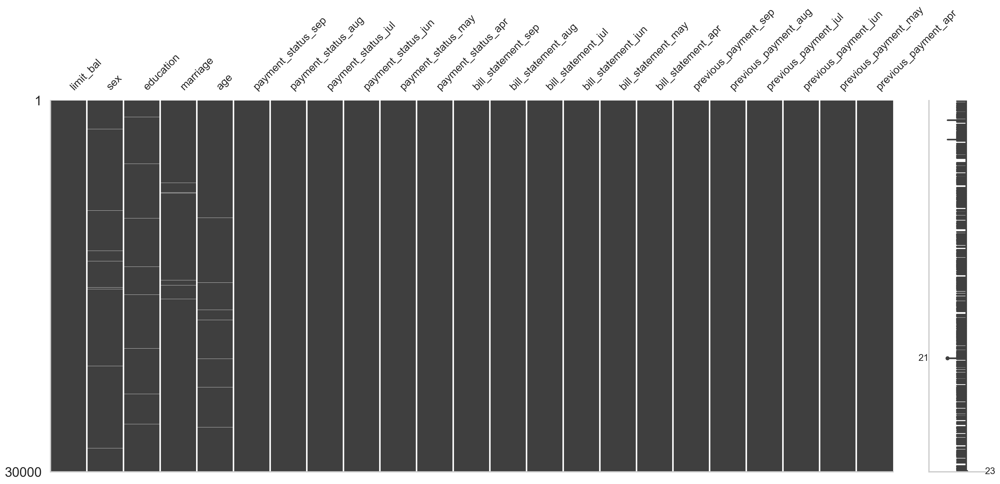

In [37]:
msno.matrix(X)

sns.despine()
# plt.savefig("images/figure_13_12", dpi=200)

4. Define columns with missing values per data type:

In [38]:
NUM_FEATURES = ["age"]
CAT_FEATURES = ["sex", "education", "marriage"]

5. Impute the numerical feature:

In [39]:
for col in NUM_FEATURES:
    num_imputer = SimpleImputer(strategy="median")
    num_imputer.fit(X_train[[col]])
    X_train.loc[:, col] = num_imputer.transform(X_train[[col]])
    X_test.loc[:, col] = num_imputer.transform(X_test[[col]])

In [14]:
# alternative method using pandas

# for feature in NUM_FEATURES:
#     median_value = X_train[feature].median()
#     X_train.loc[:, feature].fillna(median_value, inplace=True)
#     X_test.loc[:, feature].fillna(median_value, inplace=True)

6. Impute the categorical features:

In [40]:
for col in CAT_FEATURES:
    cat_imputer = SimpleImputer(strategy="most_frequent")
    cat_imputer.fit(X_train[[col]])
    X_train.loc[:, col] = cat_imputer.transform(X_train[[col]])
    X_test.loc[:, col] = cat_imputer.transform(X_test[[col]])

In [16]:
# alternative method using pandas

# for feature in CAT_FEATURES:
#     mode_value = X_train[feature].mode().values[0]
#     X_train.loc[:, feature].fillna(mode_value, inplace=True)
#     X_test.loc[:, feature].fillna(mode_value, inplace=True)

7. Verify that there are no missing values:

In [41]:
X_train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 20999 entries, 25553 to 27126
Data columns (total 23 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   limit_bal             20999 non-null  int64  
 1   sex                   20999 non-null  object 
 2   education             20999 non-null  object 
 3   marriage              20999 non-null  object 
 4   age                   20999 non-null  float64
 5   payment_status_sep    20999 non-null  object 
 6   payment_status_aug    20999 non-null  object 
 7   payment_status_jul    20999 non-null  object 
 8   payment_status_jun    20999 non-null  object 
 9   payment_status_may    20999 non-null  object 
 10  payment_status_apr    20999 non-null  object 
 11  bill_statement_sep    20999 non-null  int64  
 12  bill_statement_aug    20999 non-null  int64  
 13  bill_statement_jul    20999 non-null  int64  
 14  bill_statement_jun    20999 non-null  int64  
 15  bill_statement_may  

### There's more

We also look into the other types of visualizations offered by `missingno`.

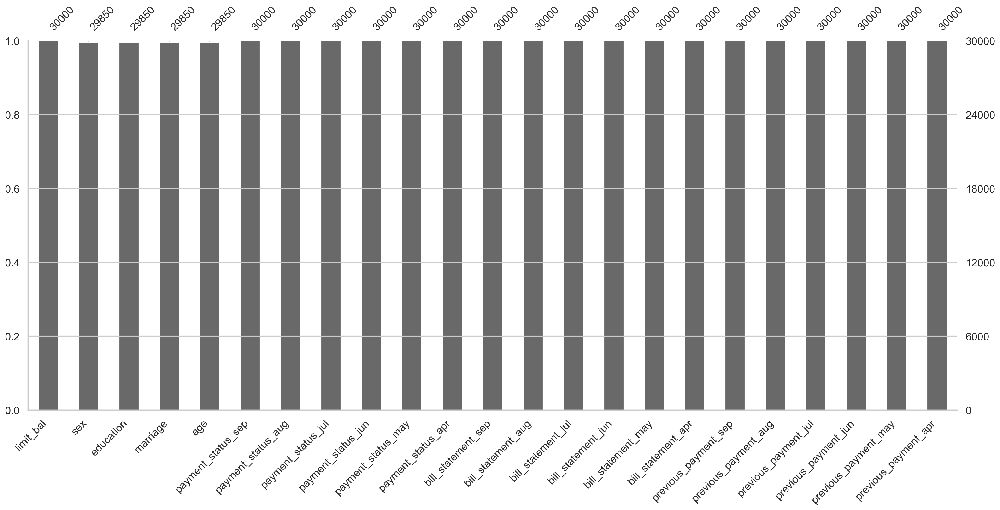

In [42]:
msno.bar(X)

sns.despine()
plt.show()

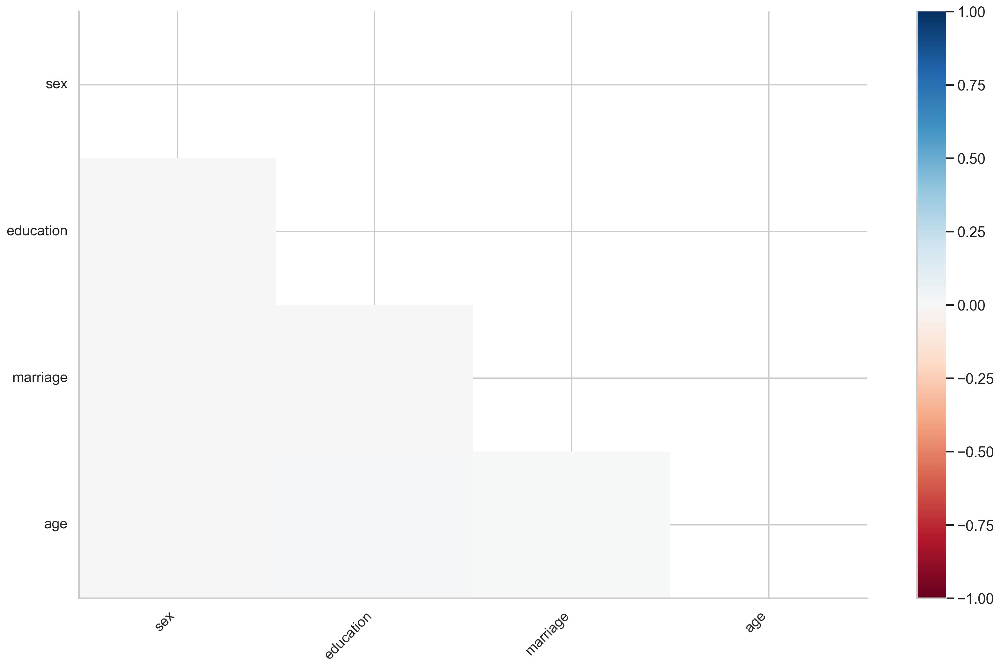

In [43]:
msno.heatmap(X)

sns.despine()
plt.show()

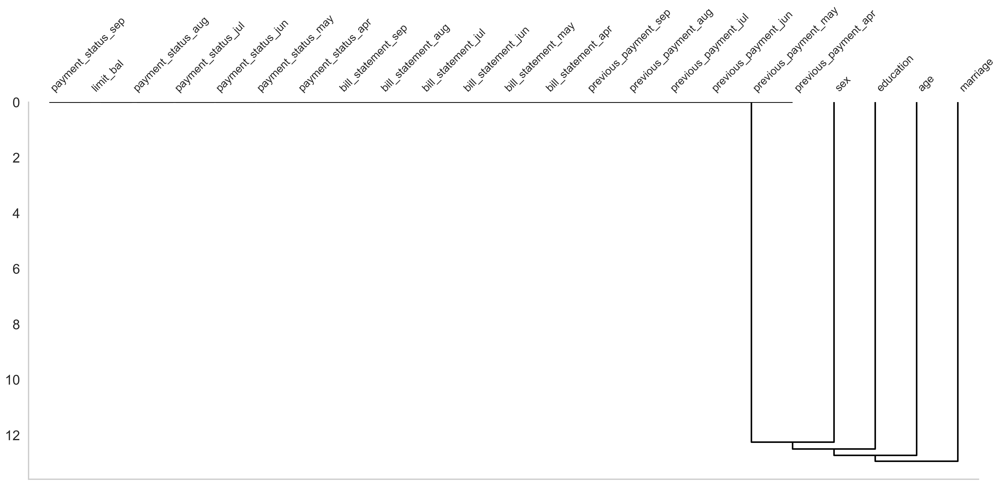

In [44]:
msno.dendrogram(X)

sns.despine()
# plt.savefig("images/figure_13_13", dpi=200)

## 13.5 Encoding categorical variables

Category 변수는 숫자형 데이터로 인코딩해야 한다.

- 레이블 인코딩
  - 각 Category 값에 숫자를 할당
  - pandas category 형식과 유사
- Onehot 인코딩
  - 각 Category 값마다 해당 값이 맞는지 여부를 나타내는 열을 추가
  - 추가된 열 중에 1개의 열은 제게 (각 열의 독립성 확보)

### How to do it...

1. Import the libraries:

In [45]:
import pandas as pd
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn.compose import ColumnTransformer

2. Use Label Encoder to encode a selected column:

In [46]:
COL = "education"

X_train_copy = X_train.copy()
X_test_copy = X_test.copy()

label_enc = LabelEncoder()
label_enc.fit(X_train_copy[COL])
X_train_copy.loc[:, COL] = label_enc.transform(X_train_copy[COL])
X_test_copy.loc[:, COL] = label_enc.transform(X_test_copy[COL])

X_test_copy[COL].head()

24775    3
9945     0
6150     1
25097    1
7745     3
Name: education, dtype: object

In [47]:
label_enc.classes_

array(['Graduate school', 'High school', 'Others', 'University'],
      dtype=object)

3. Select categorical features for one-hot encoding:

In [48]:
cat_features = X_train.select_dtypes(include="object") \
                      .columns \
                      .to_list()

cat_features

['sex',
 'education',
 'marriage',
 'payment_status_sep',
 'payment_status_aug',
 'payment_status_jul',
 'payment_status_jun',
 'payment_status_may',
 'payment_status_apr']

4. Instantiate the `OneHotEncoder` object: 

In [49]:
one_hot_encoder = OneHotEncoder(sparse=False, 
                                handle_unknown="error", 
                                drop="first")

5. Create the column transformer using the one-hot encoder: 

In [50]:
one_hot_transformer = ColumnTransformer(
    [("one_hot", one_hot_encoder, cat_features)],
    remainder="passthrough",
    verbose_feature_names_out=False
)

6. Fit the transformer:

In [51]:
one_hot_transformer.fit(X_train)

ColumnTransformer(remainder='passthrough',
                  transformers=[('one_hot',
                                 OneHotEncoder(drop='first', sparse=False),
                                 ['sex', 'education', 'marriage',
                                  'payment_status_sep', 'payment_status_aug',
                                  'payment_status_jul', 'payment_status_jun',
                                  'payment_status_may',
                                  'payment_status_apr'])],
                  verbose_feature_names_out=False)

7. Apply the transformations to both training and test sets:

In [52]:
col_names = one_hot_transformer.get_feature_names_out()

X_train_ohe = pd.DataFrame(one_hot_transformer.transform(X_train), 
                           columns=col_names, 
                           index=X_train.index)

X_test_ohe = pd.DataFrame(one_hot_transformer.transform(X_test), 
                          columns=col_names, 
                          index=X_test.index)

Below we can see how one-hot encoding increased the shape of our DataFrame:

In [53]:
X_train.shape

(20999, 23)

In [54]:
X_train_ohe.shape

(20999, 72)

In [55]:
X_train_ohe.to_csv("X_train_ohe.csv", index=True)
X_test_ohe.to_csv("X_test_ohe.csv", index=True)
y_train.to_csv("y_train.csv", index=True)
y_test.to_csv("y_test.csv", index=True)

### There's more

#### Using `pandas` for one-hot encoding

pandas one-hot 인코딩을 사용하면 쉽게 작업할 수 있으나 scikit-learn의 Pipeline에 통합하지 못한다.

In [56]:
pd.get_dummies(X_train, prefix_sep="_", drop_first=True)

,limit_bal,age,bill_statement_sep,bill_statement_aug,bill_statement_jul,bill_statement_jun,bill_statement_may,bill_statement_apr,previous_payment_sep,previous_payment_aug,...,payment_status_may_Payment delayed 8 months,payment_status_may_Unknown,payment_status_apr_Payment delayed 2 months,payment_status_apr_Payment delayed 3 months,payment_status_apr_Payment delayed 4 months,payment_status_apr_Payment delayed 5 months,payment_status_apr_Payment delayed 6 months,payment_status_apr_Payment delayed 7 months,payment_status_apr_Payment delayed 8 months,payment_status_apr_Unknown
25553,320000,37.0,202442,187475,164694,148160,132230,121191,8211,6100,...,False,True,False,False,False,False,False,False,False,True
14463,500000,35.0,1369,6138,20424,7840,846,790,4769,19629,...,False,True,False,False,False,False,False,False,False,False
27267,160000,42.0,14137,13613,14634,16532,15969,17701,0,1247,...,False,False,True,False,False,False,False,False,False,False
18620,20000,26.0,1000,8930,0,0,0,790,8930,0,...,False,True,False,False,False,False,False,False,False,True
12238,20000,22.0,11999,3617,4165,6323,0,0,1062,1000,...,False,False,False,False,False,False,False,False,False,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25780,200000,32.0,10701,0,0,0,0,0,0,0,...,False,True,False,False,False,False,False,False,False,True
13921,120000,24.0,112336,113351,115515,113948,122127,121962,4200,4100,...,False,True,True,False,False,False,False,False,False,False
3794,120000,24.0,75796,76004,67187,49924,33188,19826,3700,2023,...,False,True,False,False,False,False,False,False,False,True
27565,360000,57.0,0,0,860,246,-46,-46,0,860,...,False,False,False,False,False,False,False,False,False,True


#### Specifying possible categories for OneHotEncoder

In [57]:
one_hot_encoder = OneHotEncoder(
    categories=[["Male", "Female", "Unknown"]], 
    sparse=False, 
    handle_unknown="error", 
    drop="first"
)

one_hot_transformer = ColumnTransformer(
    [("one_hot", one_hot_encoder, ["sex"])]
)

one_hot_transformer.fit(X_train)
one_hot_transformer.get_feature_names_out()

array(['one_hot__sex_Female', 'one_hot__sex_Unknown'], dtype=object)

#### Category Encoders library

In [59]:
import category_encoders as ce

In [60]:
one_hot_encoder_ce = ce.OneHotEncoder(use_cat_names=True)

In [61]:
one_hot_encoder_ce.fit(X_train)
X_train_ce = one_hot_encoder_ce.transform(X_train)
X_train_ce.head()

,limit_bal,sex_Female,sex_Male,education_University,education_Graduate school,education_High school,education_Others,marriage_Married,marriage_Single,marriage_Others,...,bill_statement_jul,bill_statement_jun,bill_statement_may,bill_statement_apr,previous_payment_sep,previous_payment_aug,previous_payment_jul,previous_payment_jun,previous_payment_may,previous_payment_apr
25553,320000,1,0,1,0,0,0,1,0,0,...,164694,148160,132230,121191,8211,6100,6094,5035,4446,5028
14463,500000,0,1,0,1,0,0,0,1,0,...,20424,7840,846,790,4769,19629,157,0,790,860
27267,160000,0,1,0,1,0,0,1,0,0,...,14634,16532,15969,17701,0,1247,2145,0,2000,0
18620,20000,1,0,0,1,0,0,0,1,0,...,0,0,0,790,8930,0,0,0,790,0
12238,20000,1,0,1,0,0,0,0,1,0,...,4165,6323,0,0,1062,1000,10488,0,0,0


#### Accessing the `category` encoding

In [63]:
column_dtypes = {
    "education": "category", 
    "marriage": "category", 
    "sex": "category"
}
df_cat = pd.read_csv("../credit_card_default.csv", 
                     na_values="", dtype=column_dtypes)

In [64]:
df_cat["education"].cat.codes

0        3
1        3
2        3
3        3
4        3
        ..
29995    1
29996    1
29997    3
29998    1
29999    3
Length: 30000, dtype: int8

In [65]:
dict(zip(df_cat["education"].cat.codes, df_cat["education"]))

{3: 'University', 0: 'Graduate school', 1: 'High school', 2: 'Others', -1: nan}

## 13.6 Fitting a decision tree classifier

의사 결정 트리는 회귀 문제와 분류 문제를 처리할 수 있는 간단하지만 중요한 머신러닝 알고리즘
- 각 Tree의 노드는 하나의 열의 조건으로 데이터를 분리
- 이러한 노드가 Tree를 이루면서 불순도가 낮은(가능하면 동일한 답을 가지는) 데이터들로 분리한다.
- 이때 Greedy algorithm을 사용하여 최소화 한다.
- 불순도는 Gini 불순도나 엔트로피를 사용 (회귀 문제는 MSE, MAE를 사용)

의사결정 트리의 장점
- 트리 형태로 쉽게 시각화 가능 - 해석이 용이함
- 학습 및 예측 단계가 빠름
- 튜닝해야 할 하이퍼파라미터의 수가 비교적 적음
- 수치형 및 범주형 피처를 지원함
- 데이터의 비선형성을 처리할 수 있음
- 피처 엔지니어링을 통해 성능 향상이 가능하지만 필수는 아님
- 스케일링 또는 정규화가 필요 없음
- 샘플을 분할할 피처를 선택함으로써 피처 선택 기능을 포함함
- 비모수 모델로서, 피처/타겟 분포에 대한 가정이 필요 없음

의사결정 트리의 단점
- 불안정성 - 입력 데이터의 노이즈에 민감하여, 데이터의 작은 변화가 모델에 큰 영향을 미칠 수 있음
- 과적합 - 최대값 또는 중지 기준을 제공하지 않으면, 트리가 너무 깊어져 일반화가 어려워질 수 있음
- 외삽 불가 - 훈련 데이터의 경계를 벗어난 관측값에 대해 일정한 예측만 수행함
- 탐욕적 알고리즘이 전역 최적의 결정 트리 선택을 보장하지 않음
- 클래스 불균형이 있는 경우 편향된 결과를 초래할 수 있음
- 범주형 변수를 포함한 트리에서 정보 이득(엔트로피 감소)은 범주 수가 많은 피처에 대해 편향된 결과를 낳을 수 있음

### Getting ready

In [66]:
import pandas as pd
X_train_ohe = pd.read_csv("X_train_ohe.csv", index_col=0)
X_test_ohe = pd.read_csv("X_test_ohe.csv", index_col=0)
y_train = pd.read_csv("y_train.csv", index_col=0)["default_payment_next_month"]
y_test = pd.read_csv("y_test.csv", index_col=0)["default_payment_next_month"]

### How to do it...

1. Import the libraries:

In [67]:
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn import metrics

from chapter_13_utils import performance_evaluation_report

2. Create the instance of the model, fit it to the training data and create prediction:

In [68]:
tree_classifier = DecisionTreeClassifier(random_state=42)
tree_classifier.fit(X_train_ohe, y_train)
y_pred = tree_classifier.predict(X_test_ohe)

3. Evaluate the results:

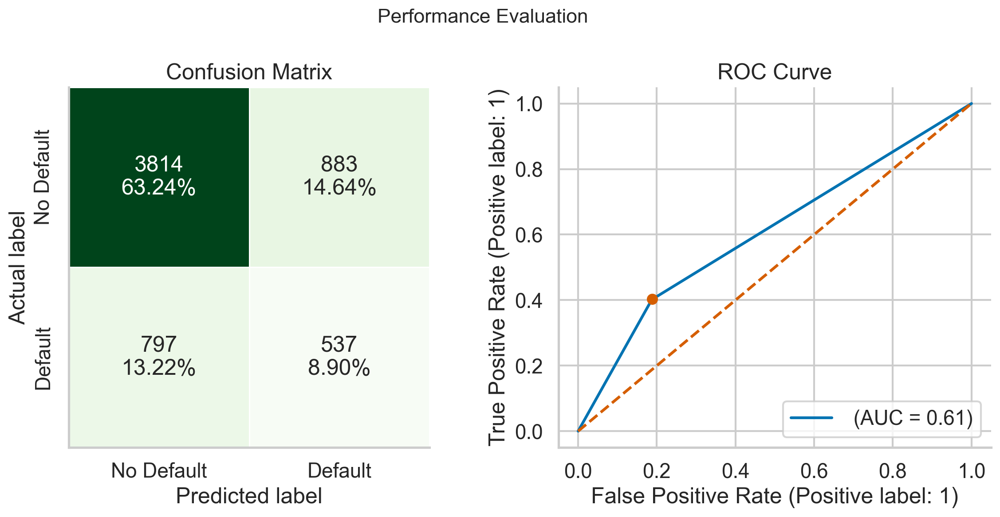

In [69]:
LABELS = ["No Default", "Default"]
tree_perf = performance_evaluation_report(tree_classifier, 
                                          X_test_ohe, 
                                          y_test, labels=LABELS, 
                                          show_plot=True)

sns.despine()
plt.tight_layout()
# plt.savefig("images/figure_13_15", dpi=200)

모델의 성능 평가

- True Positive (TP): 모델이 연체를 예측했으며, 실제로 연체가 발생한 경우
- False Positive (FP): 모델이 연체를 예측했지만, 실제로는 연체가 발생하지 않은 경우
- True Negative (TN): 모델이 정상 고객을 예측했으며, 실제로도 연체가 발생하지 않은 경우
- False Negative (FN): 모델이 정상 고객을 예측했지만, 실제로는 연체가 발생한 경우

평가 기준

- 정확도(Accuracy): (TP + TN) / (TP + TN + FP + FN) - 관측값의 클래스를 올바르게 예측할 모델의 전체 능력을 측정
- 정밀도(Precision): TP / (TP + FP) - 양성으로 예측된 모든 값 중 실제로 양성인 값의 비율을 측정
- 재현율(Recall): TP / (TP + FN) - 실제 양성 값 중에서 얼마나 많은 양성을 정확히 예측했는지를 측정
- F1 점수**: 정밀도와 재현율의 조화 평균을 사용. 극단적인 값에 대한 페널티를 주며, 비슷하지 않은 값을 억제
- 특이도(Specificity): TN / (TN + FP) - 실제로 연체가 발생하지 않은 경우 중 모델이 이를 올바르게 예측한 비율을 측정



In [70]:
tree_perf

{'accuracy': 0.7214392306416846,
 'precision': 0.37816901408450704,
 'recall': 0.4025487256371814,
 'specificity': 0.8120076644666808,
 'f1_score': 0.3899782135076253,
 'cohens_kappa': 0.20971632534408502,
 'matthews_corr_coeff': 0.20988814786286436,
 'roc_auc': 0.6071302490121769,
 'pr_auc': 0.4562496247182579,
 'average_precision': 0.2844892909582708}

4. Plot the first few levels of the fitted decision tree:

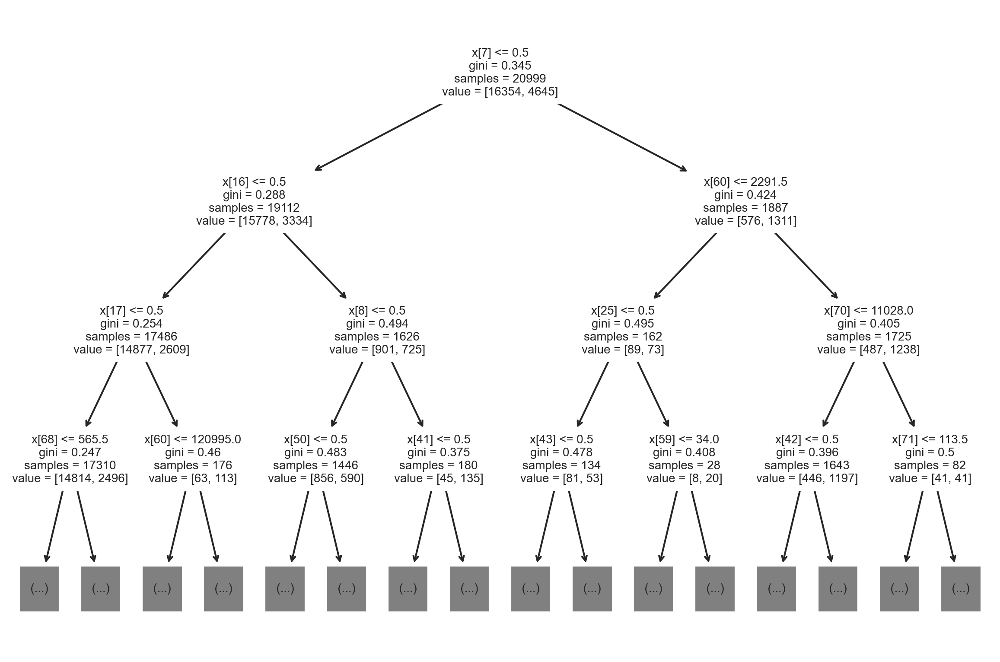

In [71]:
plot_tree(tree_classifier, max_depth=3, fontsize=10)

sns.despine()
plt.tight_layout()
# plt.savefig("images/figure_13_16", dpi=200)

In [72]:
tree_classifier.get_depth()

41

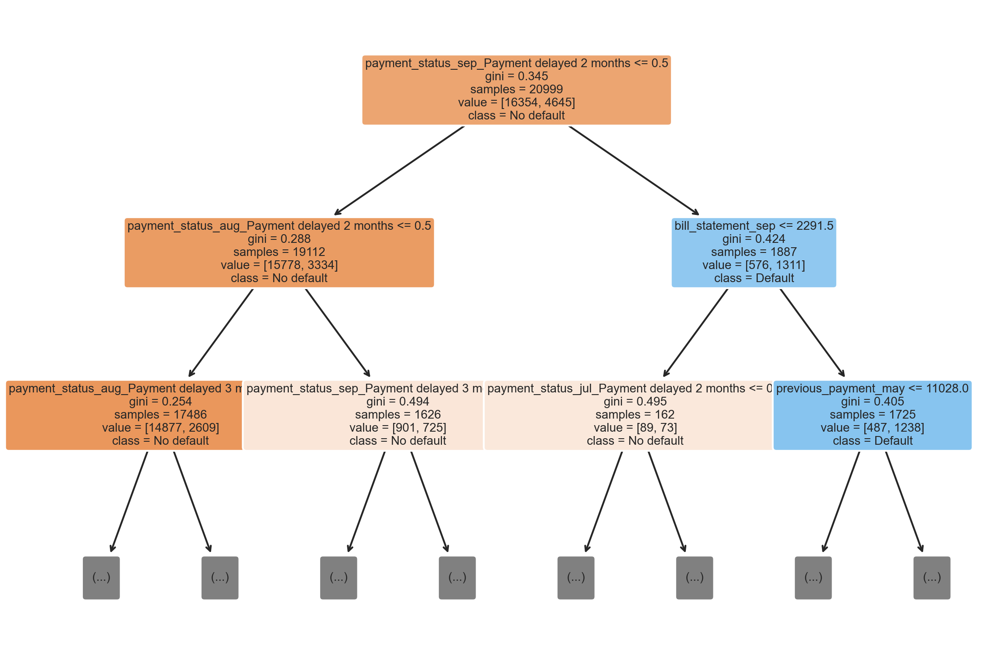

In [73]:
plot_tree(
    tree_classifier, 
    max_depth=2,
    feature_names = X_train_ohe.columns, 
    class_names=["No default", "Default"],
    rounded=True, 
    filled = True, 
    fontsize=10
)

sns.despine()
plt.tight_layout()
# plt.savefig("images/figure_13_17", dpi=200)

### There's more

**Precision-recall curve**

In [74]:
y_pred_prob = tree_classifier.predict_proba(X_test_ohe)[:, 1]

precision, recall, _ = metrics.precision_recall_curve(y_test, 
                                                      y_pred_prob)

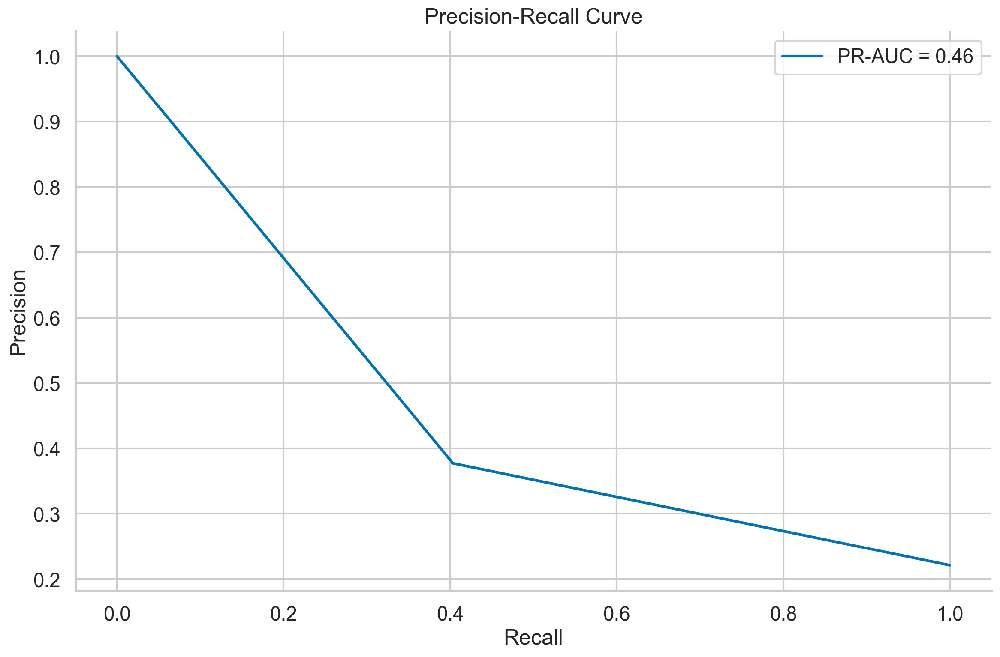

In [75]:
ax = plt.subplot()
ax.plot(recall, precision, 
        label=f"PR-AUC = {metrics.auc(recall, precision):.2f}")
ax.set(title="Precision-Recall Curve", 
       xlabel="Recall", 
       ylabel="Precision")
ax.legend()

sns.despine()
plt.tight_layout()
# plt.savefig("images/figure_13_19", dpi=200)

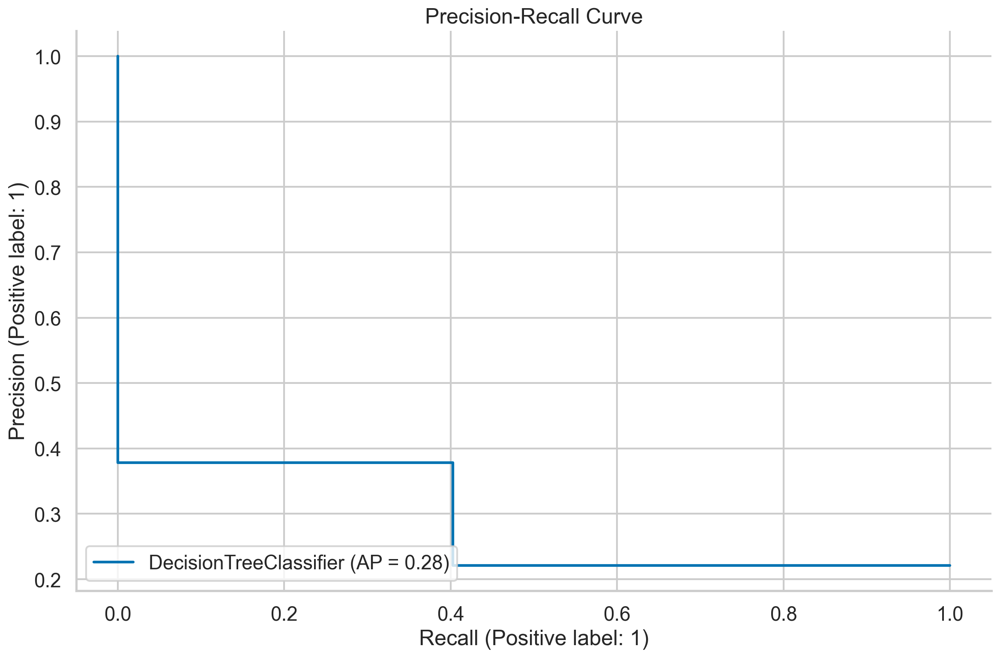

In [76]:
ax = metrics.PrecisionRecallDisplay.from_estimator(
    tree_classifier, X_test_ohe, y_test
)
ax.ax_.set_title("Precision-Recall Curve")

sns.despine()
plt.tight_layout()
# plt.savefig("images/figure_13_20", dpi=200)

**Visualizing decision trees using `dtreeviz`**

1. Import the libraries:

In [83]:
from dtreeviz.trees import *
import dtreeviz

2. Fit a small decision tree with max depth of 3:

In [84]:
small_tree = DecisionTreeClassifier(max_depth=3, 
                                    random_state=42)
small_tree.fit(X_train_ohe, y_train)

DecisionTreeClassifier(max_depth=3, random_state=42)

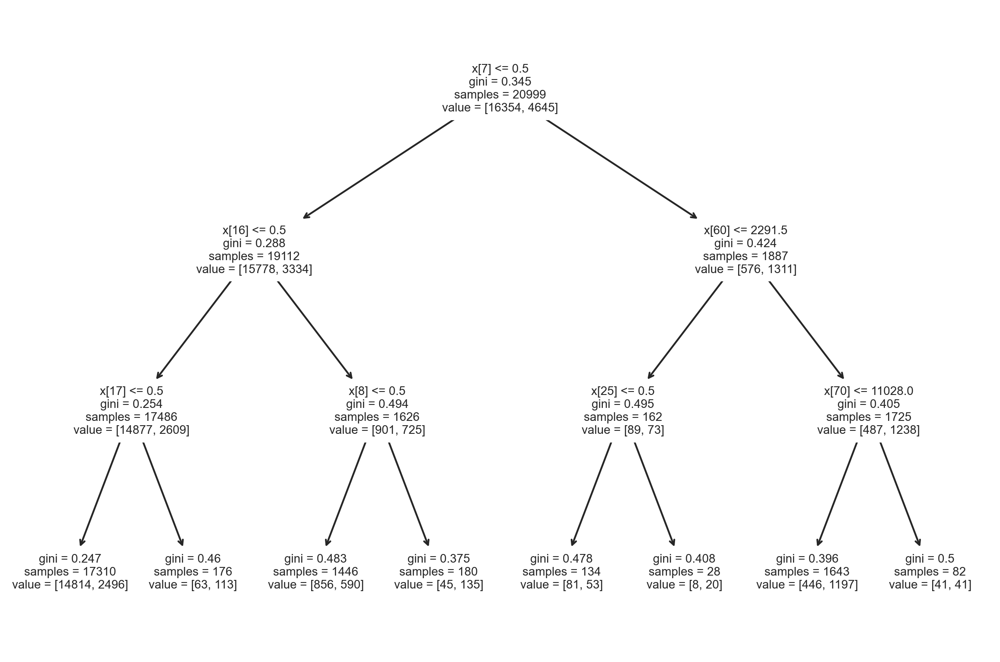

In [85]:
plot_tree(small_tree, max_depth=3, fontsize=10)

sns.despine()
plt.tight_layout()

3. Plot the decision tree using `dtreeviz`:

C:\Users\syahn\.conda\envs\cookbook3.8\lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


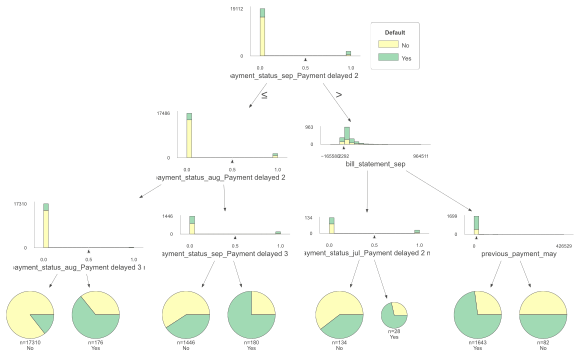

In [92]:
viz = dtreeviz.model(small_tree, 
               X_train=X_train_ohe,
               y_train=y_train,
               feature_names=X_train_ohe.columns, 
               target_name="Default",
               class_names=["No", "Yes"])
#               , title="Decision Tree - Loan default data set")
viz.view(scale=0.8)

4. Plot the simplified tree representation:

C:\Users\syahn\.conda\envs\cookbook3.8\lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


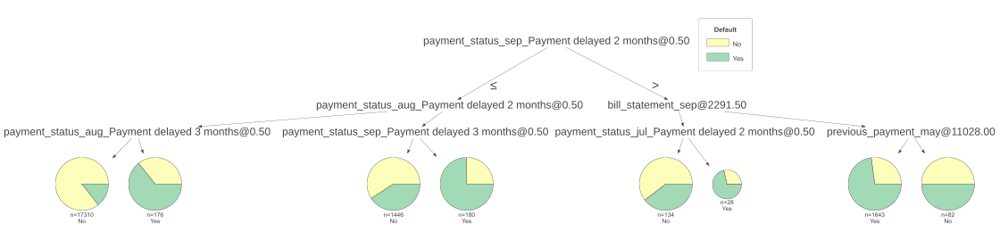

In [95]:
viz = dtreeviz.model(small_tree, 
               X_train=X_train_ohe,
               y_train=y_train,
               feature_names=X_train_ohe.columns, 
               target_name="Default",
               class_names=["No", "Yes"])
#              , title="Decision Tree - Loan default data set",
#               fancy=False)
viz.view(fancy=False)

5. Plot the simplified tree representation and the decision path of the first observation from the test set:

C:\Users\syahn\.conda\envs\cookbook3.8\lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


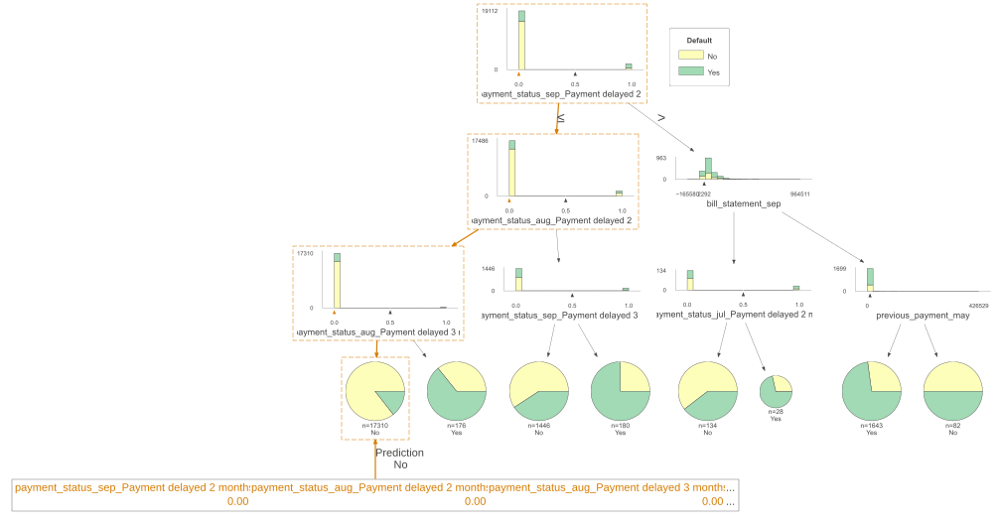

In [97]:
viz = dtreeviz.model(small_tree, 
               X_train=X_train_ohe,
               y_train=y_train,
               feature_names=X_train_ohe.columns, 
               target_name="Default",
               class_names=["No", "Yes"])
#               title="Decision Tree - Loan default data set",
#               fancy=False,
#               X=X_test_ohe.iloc[0])
viz.view(x=X_test_ohe.iloc[0])

7. Print the prediction path using words:

In [102]:
#print(explain_prediction_path(small_tree, X_test_ohe.iloc[0], 
#                              feature_names=X_test_ohe.columns, 
#                              explanation_type="plain_english"))
print(viz.explain_prediction_path(X_test_ohe.iloc[0]))

payment_status_sep_Payment delayed 2 months < 0.5
payment_status_aug_Payment delayed 2 months < 0.5
payment_status_aug_Payment delayed 3 months < 0.5



## 13.7 Organizing the project with pipelines

### How to do it...

1. Import the libraries:

In [103]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.tree import DecisionTreeClassifier
from sklearn.pipeline import Pipeline
from chapter_13_utils import performance_evaluation_report

2. Load the data, separate the target and create the stratified train-test split:

In [105]:
df = pd.read_csv("../credit_card_default.csv", na_values="")

X = df.copy()
y = X.pop("default_payment_next_month")

X_train, X_test, y_train, y_test = train_test_split(X, y, 
                                                    test_size=0.2, 
                                                    stratify=y, 
                                                    random_state=42)

3. Prepare lists of numerical/categorical features:

In [106]:
num_features = X_train.select_dtypes(include="number") \
                      .columns \
                      .to_list()
cat_features = X_train.select_dtypes(include="object") \
                      .columns \
                      .to_list()

In [107]:
# sanity check that all columns are included in the lists
len(X_train.columns) == (len(num_features) + len(cat_features))

True

4. Define the numerical pipeline:

In [108]:
num_pipeline = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="median"))
])

5. Define the categorical pipeline:

In [109]:
cat_list = [
    list(X_train[col].dropna().unique()) for col in cat_features
]

cat_pipeline = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="most_frequent")),
    ("onehot", OneHotEncoder(categories=cat_list, 
                             sparse=False, 
                             handle_unknown="error", 
                             drop="first"))
])

6. Define the `ColumnTransformer` object: 

In [110]:
preprocessor = ColumnTransformer(
    transformers=[
        ("numerical", num_pipeline, num_features),
        ("categorical", cat_pipeline, cat_features)
    ], 
    remainder="drop"
)

7. Define the full pipeline including the decision tree model: 

In [111]:
dec_tree = DecisionTreeClassifier(random_state=42)

tree_pipeline = Pipeline(steps=[
    ("preprocessor", preprocessor),
    ("classifier", dec_tree)
])

8. Fit the pipeline to the data:

In [112]:
tree_pipeline.fit(X_train, y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('numerical',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median'))]),
                                                  ['limit_bal', 'age',
                                                   'bill_statement_sep',
                                                   'bill_statement_aug',
                                                   'bill_statement_jul',
                                                   'bill_statement_jun',
                                                   'bill_statement_may',
                                                   'bill_statement_apr',
                                                   'previous_payment_sep',
                                                   'previous_payment_aug',
                                                   'previous_payment_j...
                                                                                              '3 '
                                                                                              'months',
                                                                                              'Payment '
                                                                                              'delayed '
                                                                                              '7 '
                                                                                              'months',
                                                                                              'Payment '
                                                                                              'delayed '
                                                                                              '5 '
                                                                                              'months',
                                                                                              'Payment '
                                                                                              'delayed '
                                                                                              '8 '
                                                                                              'months']],
                                                                                 drop='first',
                                                                                 sparse=False))]),
                                                  ['sex', 'education',
                                                   'marriage',
                                                   'payment_status_sep',
                                                   'payment_status_aug',
                                                   'payment_status_jul',
                                                   'payment_status_jun',
                                                   'payment_status_may',
                                                   'payment_status_apr'])])),
                ('classifier', DecisionTreeClassifier(random_state=42))])

9. Evaluate the performance of the entire pipeline:

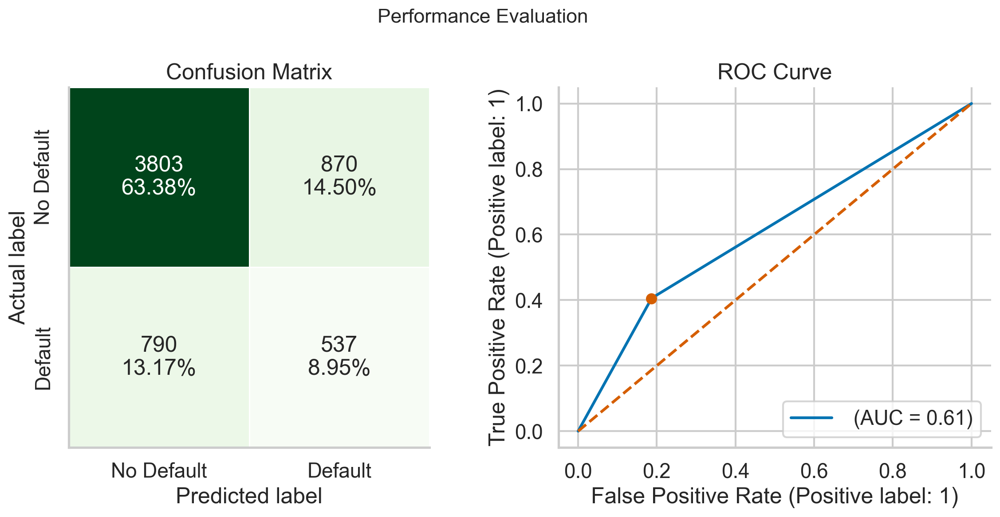

In [113]:
LABELS = ["No Default", "Default"]
tree_perf = performance_evaluation_report(tree_pipeline, X_test, 
                                          y_test, labels=LABELS, 
                                          show_plot=True)

sns.despine()
plt.tight_layout()
# plt.savefig("images/figure_13_23", dpi=200)

In [114]:
tree_perf

{'accuracy': 0.7233333333333334,
 'precision': 0.3816631130063966,
 'recall': 0.4046721929163527,
 'specificity': 0.8138240958698909,
 'f1_score': 0.3928310168251646,
 'cohens_kappa': 0.21388003714653614,
 'matthews_corr_coeff': 0.2140336931441623,
 'roc_auc': 0.6095279347712678,
 'pr_auc': 0.4589251149708047,
 'average_precision': 0.28616835280766334}

### There's more

#### Adding custom transformers to a pipeline

1. Import the base estimator and transformer classes from `sklearn`: 

In [115]:
from sklearn.base import BaseEstimator, TransformerMixin
import numpy as np

2. Define the `OutlierRemover` class:

In [116]:
class OutlierRemover(BaseEstimator, TransformerMixin):
    def __init__(self, n_std=3):
        self.n_std = n_std
    
    def fit(self, X, y = None):
        if np.isnan(X).any(axis=None):
            raise ValueError("""There are missing values in the array! 
                                Please remove them.""")

        mean_vec = np.mean(X, axis=0)
        std_vec = np.std(X, axis=0)
        
        self.upper_band_ = pd.Series(mean_vec + self.n_std * std_vec)
        self.upper_band_ = self.upper_band_.to_frame().transpose()
        self.lower_band_ = pd.Series(mean_vec - self.n_std * std_vec)
        self.lower_band_ = self.lower_band_.to_frame().transpose()
        self.n_features_ = len(self.upper_band_.columns)
        
        return self 
    
    def transform(self, X, y = None):
        X_copy = pd.DataFrame(X.copy())
        
        upper_band = pd.concat(
            [self.upper_band_] * len(X_copy), 
            ignore_index=True
        )
        lower_band = pd.concat(
            [self.lower_band_] * len(X_copy), 
            ignore_index=True
        )
        
        X_copy[X_copy >= upper_band] = upper_band
        X_copy[X_copy <= lower_band] = lower_band
        
        return X_copy.values

3. Add the `OutlierRemover` to the numerical pipeline:

In [117]:
num_pipeline = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="median")),
    ("outliers", OutlierRemover())
])

4. Execute the rest of the pipeline to compare the results: 

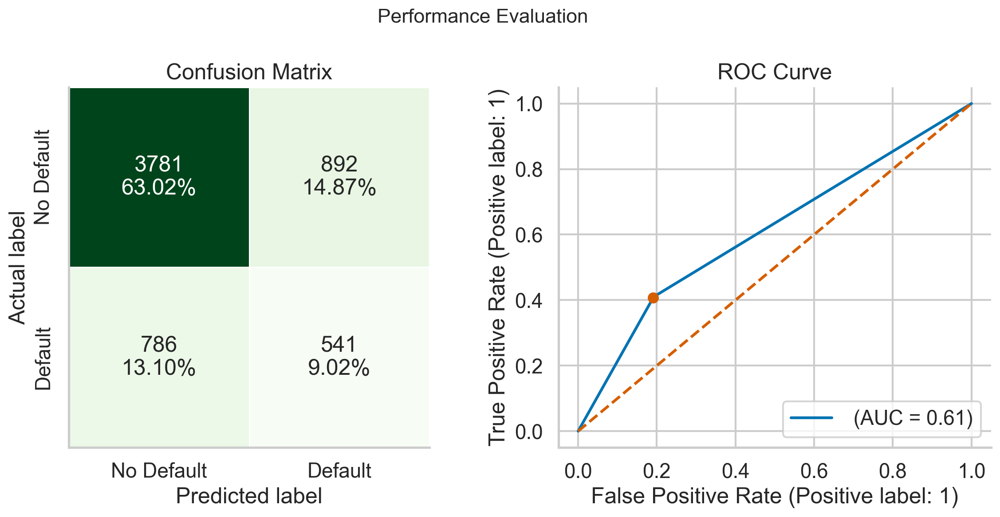

In [118]:
preprocessor = ColumnTransformer(transformers=[
    ("numerical", num_pipeline, num_features),
    ("categorical", cat_pipeline, cat_features)],
    remainder="drop")

dec_tree = DecisionTreeClassifier(random_state=42)

tree_pipeline = Pipeline(steps=[("preprocessor", preprocessor),
                                ("classifier", dec_tree)])

tree_pipeline.fit(X_train, y_train)

tree_perf = performance_evaluation_report(tree_pipeline, X_test, 
                                          y_test, labels=LABELS, 
                                          show_plot=True)

sns.despine()
plt.tight_layout()
# plt.savefig("images/figure_13_24", dpi=200)

In [119]:
tree_perf

{'accuracy': 0.7203333333333334,
 'precision': 0.377529658060014,
 'recall': 0.4076865109269028,
 'specificity': 0.8091161994436122,
 'f1_score': 0.39202898550724635,
 'cohens_kappa': 0.21077497538963086,
 'matthews_corr_coeff': 0.2110374148258694,
 'roc_auc': 0.608982787005664,
 'pr_auc': 0.4582134167657523,
 'average_precision': 0.2850810668089482}

#### Accessing the elements of the pipeline

1. Display the structure of the pipeline:

In [120]:
tree_pipeline.named_steps

{'preprocessor': ColumnTransformer(transformers=[('numerical',
                                  Pipeline(steps=[('imputer',
                                                   SimpleImputer(strategy='median')),
                                                  ('outliers',
                                                   OutlierRemover())]),
                                  ['limit_bal', 'age', 'bill_statement_sep',
                                   'bill_statement_aug', 'bill_statement_jul',
                                   'bill_statement_jun', 'bill_statement_may',
                                   'bill_statement_apr', 'previous_payment_sep',
                                   'previous_payment_aug',
                                   'previous_payment_jul...
                                                                              'months',
                                                                              'Payment '
                                          

2. Access the estimator at the end of the pipeline:

In [121]:
tree_pipeline.named_steps["classifier"]

DecisionTreeClassifier(random_state=42)

3. Access the upper thresholds of the fitted `OutlierRemover` transformer:

In [122]:
(
    tree_pipeline
    .named_steps["preprocessor"]
    .named_transformers_["numerical"]["outliers"]
    .upper_band_
)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13
0,555890.511578,62.945993,271626.004006,261528.147261,252069.405868,235292.85113,222044.17518,216598.486524,54067.496948,66637.658658,57755.3464,49971.471286,49914.412427,58779.830767


In [123]:
( 
    tree_pipeline
    .named_steps["preprocessor"]
    .transformers_[0][1]["outliers"]
    .upper_band_
)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13
0,555890.511578,62.945993,271626.004006,261528.147261,252069.405868,235292.85113,222044.17518,216598.486524,54067.496948,66637.658658,57755.3464,49971.471286,49914.412427,58779.830767


## 13.8 Tuning hyperparameters using grid search and cross-validation

### Getting ready

Please execute the code from the previous recipe before running this one!

### How to do it...

1. Import the libraries:

In [124]:
from sklearn.model_selection import (
    GridSearchCV, cross_val_score, 
    RandomizedSearchCV, cross_validate, 
    StratifiedKFold
)
from sklearn import metrics

2. Define the cross-validation scheme:

In [125]:
k_fold = StratifiedKFold(5, shuffle=True, random_state=42)

3. Evaluate the pipeline using cross-validation:

In [126]:
cross_val_score(tree_pipeline, X_train, y_train, cv=k_fold)

array([0.72333333, 0.72958333, 0.71375   , 0.723125  , 0.72      ])

4. Add extra metrics to cross-validation:

In [127]:
cv_scores = cross_validate(tree_pipeline, X_train, y_train, cv=k_fold, 
                           scoring=["accuracy", "precision", "recall", 
                                    "roc_auc"])
pd.DataFrame(cv_scores)

,fit_time,score_time,test_accuracy,test_precision,test_recall,test_roc_auc
0,1.869170,0.420913,0.723333,0.385604,0.424128,0.616333
1,1.706592,0.506690,0.729583,0.395575,0.420904,0.618938
2,1.730528,0.406947,0.713750,0.369783,0.417137,0.607940
3,1.764442,0.445848,0.723125,0.386383,0.427495,0.618066
4,1.593884,0.549579,0.720000,0.376748,0.405838,0.607129


5. Define the parameter grid:

In [128]:
param_grid = {
    "classifier__criterion": ["entropy", "gini"],
    "classifier__max_depth": range(3, 11),
    "classifier__min_samples_leaf": range(2, 11), 
    "preprocessor__numerical__outliers__n_std": [3, 4]
}

6. Run the exhaustive grid search: 

In [129]:
classifier_gs = GridSearchCV(tree_pipeline, param_grid, 
                             scoring="recall", cv=k_fold, 
                             n_jobs=-1, verbose=1)

classifier_gs.fit(X_train, y_train)

Fitting 5 folds for each of 288 candidates, totalling 1440 fits


GridSearchCV(cv=StratifiedKFold(n_splits=5, random_state=42, shuffle=True),
             estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(transformers=[('numerical',
                                                                         Pipeline(steps=[('imputer',
                                                                                          SimpleImputer(strategy='median')),
                                                                                         ('outliers',
                                                                                          OutlierRemover())]),
                                                                         ['limit_bal',
                                                                          'age',
                                                                          'bill_statement_sep',
                                                                          'bill_statement_aug',
                                                                          'bill_statement_jul',
                                                                          'bill_statement...
                                                                          'payment_status_jul',
                                                                          'payment_status_jun',
                                                                          'payment_status_may',
                                                                          'payment_status_apr'])])),
                                       ('classifier',
                                        DecisionTreeClassifier(random_state=42))]),
             n_jobs=-1,
             param_grid={'classifier__criterion': ['entropy', 'gini'],
                         'classifier__max_depth': range(3, 11),
                         'classifier__min_samples_leaf': range(2, 11),
                         'preprocessor__numerical__outliers__n_std': [3, 4]},
             scoring='recall', verbose=1)

In [130]:
print(f"Best parameters: {classifier_gs.best_params_}") 
print(f"Recall (Training set): {classifier_gs.best_score_:.4f}") 
print(f"Recall (Test set): {metrics.recall_score(y_test, classifier_gs.predict(X_test)):.4f}")

Best parameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 10, 'classifier__min_samples_leaf': 7, 'preprocessor__numerical__outliers__n_std': 4}
Recall (Training set): 0.3858
Recall (Test set): 0.3775


7. Evaluate the performance of the tuned pipeline:

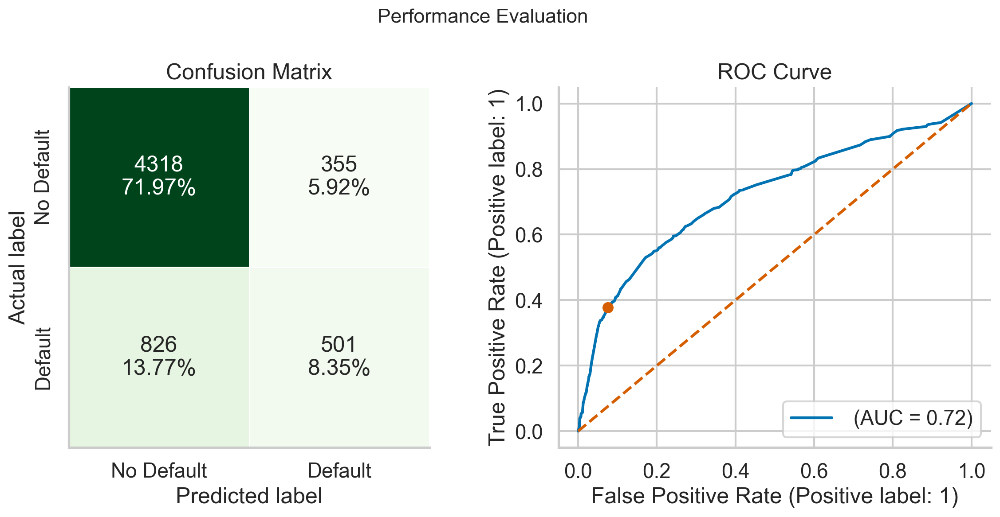

In [131]:
LABELS = ["No Default", "Default"]
tree_gs_perf = performance_evaluation_report(classifier_gs, X_test, 
                                             y_test, labels=LABELS, 
                                             show_plot=True)

sns.despine()
plt.tight_layout()
# plt.savefig("images/figure_13_26", dpi=200)

In [132]:
tree_gs_perf

{'accuracy': 0.8031666666666667,
 'precision': 0.5852803738317757,
 'recall': 0.3775433308214017,
 'specificity': 0.9240316713032314,
 'f1_score': 0.45900137425561155,
 'cohens_kappa': 0.34547526291831954,
 'matthews_corr_coeff': 0.35788321424347136,
 'roc_auc': 0.7205480311384921,
 'pr_auc': 0.4698784893189859,
 'average_precision': 0.4652985864969478}

8. Run the randomized grid search: 

In [133]:
classifier_rs = RandomizedSearchCV(tree_pipeline, param_grid, 
                                   scoring="recall", cv=k_fold, 
                                   n_jobs=-1, verbose=1, 
                                   n_iter=100, random_state=42)
classifier_rs.fit(X_train, y_train)

Fitting 5 folds for each of 100 candidates, totalling 500 fits


RandomizedSearchCV(cv=StratifiedKFold(n_splits=5, random_state=42, shuffle=True),
                   estimator=Pipeline(steps=[('preprocessor',
                                              ColumnTransformer(transformers=[('numerical',
                                                                               Pipeline(steps=[('imputer',
                                                                                                SimpleImputer(strategy='median')),
                                                                                               ('outliers',
                                                                                                OutlierRemover())]),
                                                                               ['limit_bal',
                                                                                'age',
                                                                                'bill_statement_sep',
                                                                                'bill_statement_aug',
                                                                                'bill_statement_jul',
                                                                                'bill_sta...
                                                                                'payment_status_may',
                                                                                'payment_status_apr'])])),
                                             ('classifier',
                                              DecisionTreeClassifier(random_state=42))]),
                   n_iter=100, n_jobs=-1,
                   param_distributions={'classifier__criterion': ['entropy',
                                                                  'gini'],
                                        'classifier__max_depth': range(3, 11),
                                        'classifier__min_samples_leaf': range(2, 11),
                                        'preprocessor__numerical__outliers__n_std': [3,
                                                                                     4]},
                   random_state=42, scoring='recall', verbose=1)

In [134]:
print(f"Best parameters: {classifier_rs.best_params_}") 
print(f"Recall (Training set): {classifier_rs.best_score_:.4f}") 
print(f"Recall (Test set): {metrics.recall_score(y_test, classifier_rs.predict(X_test)):.4f}")

Best parameters: {'preprocessor__numerical__outliers__n_std': 3, 'classifier__min_samples_leaf': 7, 'classifier__max_depth': 10, 'classifier__criterion': 'gini'}
Recall (Training set): 0.3854
Recall (Test set): 0.3760


9. Evaluate the performance of the Randomized Grid Search:

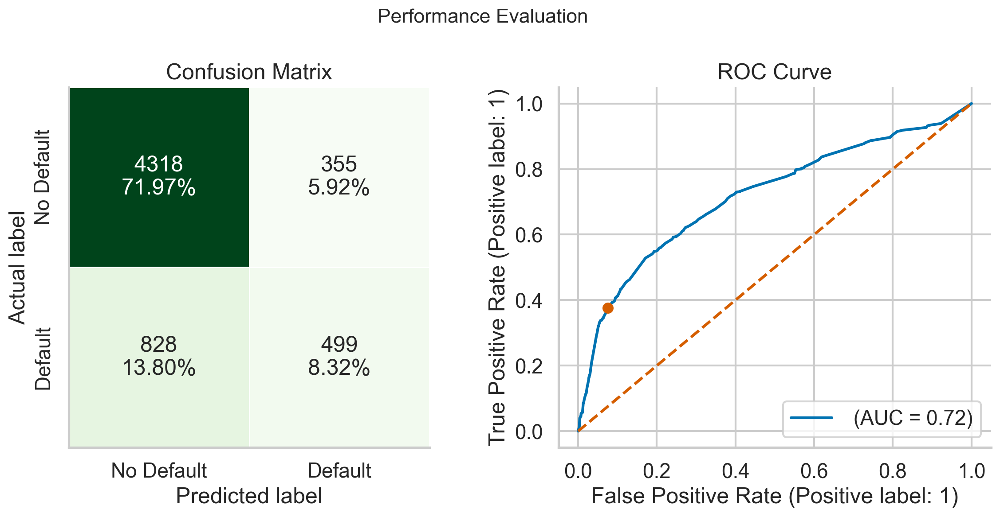

In [135]:
tree_rs_perf = performance_evaluation_report(classifier_rs, X_test, 
                                             y_test, labels=LABELS, 
                                             show_plot=True)

sns.despine()
plt.tight_layout()

In [136]:
tree_rs_perf

{'accuracy': 0.8028333333333333,
 'precision': 0.5843091334894613,
 'recall': 0.3760361718161266,
 'specificity': 0.9240316713032314,
 'f1_score': 0.45758826226501603,
 'cohens_kappa': 0.3439613201516819,
 'matthews_corr_coeff': 0.3564420906256157,
 'roc_auc': 0.7188330048148133,
 'pr_auc': 0.4686663337519278,
 'average_precision': 0.46397440653315936}

### There's more

#### Faster search with successive halving

In [137]:
from sklearn.experimental import enable_halving_search_cv
from sklearn.model_selection import HalvingGridSearchCV

# using the default values for min_resources and factor
classifier_sh = HalvingGridSearchCV(tree_pipeline, param_grid, 
                                    scoring="recall", cv=k_fold, 
                                    n_jobs=-1, verbose=1, 
                                    min_resources="exhaust", factor=3)

classifier_sh.fit(X_train, y_train)


n_iterations: 6
n_required_iterations: 6
n_possible_iterations: 6
min_resources_: 98
max_resources_: 24000
aggressive_elimination: False
factor: 3
----------
iter: 0
n_candidates: 288
n_resources: 98
Fitting 5 folds for each of 288 candidates, totalling 1440 fits
----------
iter: 1
n_candidates: 96
n_resources: 294
Fitting 5 folds for each of 96 candidates, totalling 480 fits
----------
iter: 2
n_candidates: 32
n_resources: 882
Fitting 5 folds for each of 32 candidates, totalling 160 fits
----------
iter: 3
n_candidates: 11
n_resources: 2646
Fitting 5 folds for each of 11 candidates, totalling 55 fits
----------
iter: 4
n_candidates: 4
n_resources: 7938
Fitting 5 folds for each of 4 candidates, totalling 20 fits
----------
iter: 5
n_candidates: 2
n_resources: 23814
Fitting 5 folds for each of 2 candidates, totalling 10 fits


HalvingGridSearchCV(cv=StratifiedKFold(n_splits=5, random_state=42, shuffle=True),
                    estimator=Pipeline(steps=[('preprocessor',
                                               ColumnTransformer(transformers=[('numerical',
                                                                                Pipeline(steps=[('imputer',
                                                                                                 SimpleImputer(strategy='median')),
                                                                                                ('outliers',
                                                                                                 OutlierRemover())]),
                                                                                ['limit_bal',
                                                                                 'age',
                                                                                 'bill_statement_sep',
                                                                                 'bill_statement_aug',
                                                                                 'bill_statement_jul',
                                                                                 'bill_st...
                                                                                 'payment_status_jul',
                                                                                 'payment_status_jun',
                                                                                 'payment_status_may',
                                                                                 'payment_status_apr'])])),
                                              ('classifier',
                                               DecisionTreeClassifier(random_state=42))]),
                    n_jobs=-1,
                    param_grid={'classifier__criterion': ['entropy', 'gini'],
                                'classifier__max_depth': range(3, 11),
                                'classifier__min_samples_leaf': range(2, 11),
                                'preprocessor__numerical__outliers__n_std': [3,
                                                                             4]},
                    scoring='recall', verbose=1)

In [138]:
print(f"Best parameters: {classifier_sh.best_params_}") 
print(f"Recall (Training set): {classifier_sh.best_score_:.4f}") 
print(f"Recall (Test set): {metrics.recall_score(y_test, classifier_sh.predict(X_test)):.4f}")

Best parameters: {'classifier__criterion': 'entropy', 'classifier__max_depth': 10, 'classifier__min_samples_leaf': 2, 'preprocessor__numerical__outliers__n_std': 4}
Recall (Training set): 0.3808
Recall (Test set): 0.3564


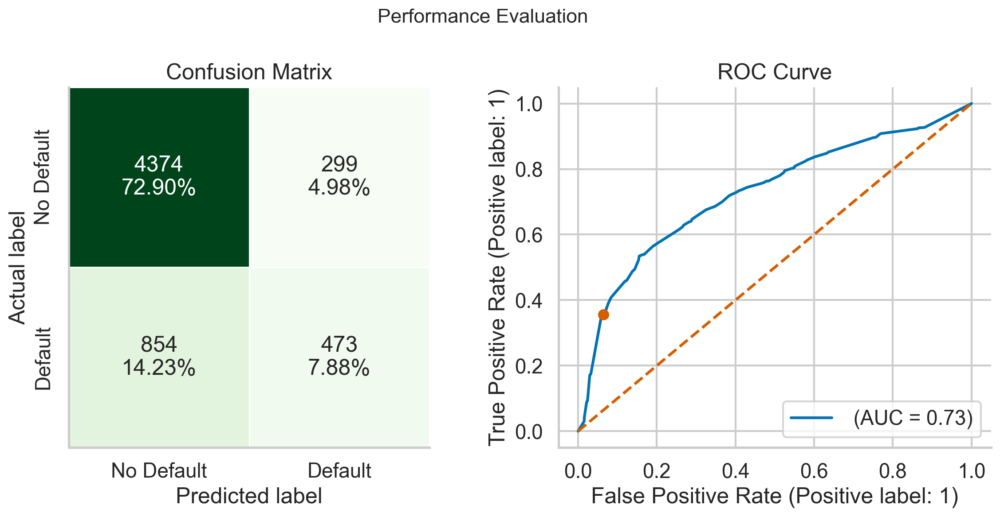

In [139]:
tree_sh_perf = performance_evaluation_report(classifier_sh, X_test, 
                                             y_test, labels=LABELS, 
                                             show_plot=True)

sns.despine()
plt.tight_layout()

In [140]:
pd.DataFrame(
    data = [
        classifier_gs.best_params_, 
        classifier_rs.best_params_, 
        classifier_sh.best_params_
    ],
    index = ["grid_search", "randomized_search", "halving_search"]
)

,classifier__criterion,classifier__max_depth,classifier__min_samples_leaf,preprocessor__numerical__outliers__n_std
grid_search,gini,10,7,4
randomized_search,gini,10,7,3
halving_search,entropy,10,2,4


In [141]:
pd.DataFrame(
    data = [tree_gs_perf, tree_rs_perf, tree_sh_perf],
    index = ["grid_search", "randomized_search", "halving_search"]
).round(3)

,accuracy,precision,recall,specificity,f1_score,cohens_kappa,matthews_corr_coeff,roc_auc,pr_auc,average_precision
grid_search,0.803,0.585,0.378,0.924,0.459,0.345,0.358,0.721,0.470,0.465
randomized_search,0.803,0.584,0.376,0.924,0.458,0.344,0.356,0.719,0.469,0.464
halving_search,0.808,0.613,0.356,0.936,0.451,0.344,0.363,0.726,0.457,0.450


#### Grid search with multiple classifiers

In [142]:
from sklearn.ensemble import RandomForestClassifier

In [143]:
param_grid = [
    {"classifier": [RandomForestClassifier(random_state=42)],
     "classifier__n_estimators": np.linspace(100, 500, 10, dtype=int),
     "classifier__max_depth": range(3, 11),
     "preprocessor__numerical__outliers__n_std": [3, 4]},
    {"classifier": [DecisionTreeClassifier(random_state=42)],
     "classifier__criterion": ["entropy", "gini"],
     "classifier__max_depth": range(3, 11),
     "classifier__min_samples_leaf": range(2, 11),
     "preprocessor__numerical__outliers__n_std": [3, 4]}
]

In [144]:
classifier_gs_2 = GridSearchCV(tree_pipeline, param_grid, 
                               scoring="recall", cv=k_fold, 
                               n_jobs=-1, verbose=1)

classifier_gs_2.fit(X_train, y_train)

print(f"Best parameters: {classifier_gs_2.best_params_}") 
print(f"Recall (Training set): {classifier_gs_2.best_score_:.4f}") 
print(f"Recall (Test set): {metrics.recall_score(y_test, classifier_gs_2.predict(X_test)):.4f}")

Fitting 5 folds for each of 448 candidates, totalling 2240 fits
Best parameters: {'classifier': DecisionTreeClassifier(random_state=42), 'classifier__criterion': 'gini', 'classifier__max_depth': 10, 'classifier__min_samples_leaf': 7, 'preprocessor__numerical__outliers__n_std': 4}
Recall (Training set): 0.3858
Recall (Test set): 0.3775


In [145]:
pd.DataFrame(classifier_gs_2.cv_results_).sort_values("rank_test_score")

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_classifier,param_classifier__max_depth,param_classifier__n_estimators,param_preprocessor__numerical__outliers__n_std,param_classifier__criterion,param_classifier__min_samples_leaf,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
441,2.909689,0.105546,0.544757,0.117758,DecisionTreeClassifier(random_state=42),10,NaN,4,gini,7,{'classifier': DecisionTreeClassifier(random_s...,0.419416,0.359699,0.393597,0.386064,0.370056,0.385766,0.020591,1
419,2.932228,0.119055,0.554331,0.067718,DecisionTreeClassifier(random_state=42),9,NaN,4,gini,5,{'classifier': DecisionTreeClassifier(random_s...,0.394910,0.386064,0.387006,0.363465,0.397363,0.385762,0.011976,2
418,2.831895,0.063808,0.469755,0.044639,DecisionTreeClassifier(random_state=42),9,NaN,3,gini,5,{'classifier': DecisionTreeClassifier(random_s...,0.391140,0.386064,0.389831,0.363465,0.397363,0.385573,0.011637,3
440,3.078442,0.146414,0.494889,0.040249,DecisionTreeClassifier(random_state=42),10,NaN,3,gini,7,{'classifier': DecisionTreeClassifier(random_s...,0.415646,0.360640,0.393597,0.387006,0.370056,0.385389,0.019147,4
437,3.221464,0.150480,0.551738,0.059823,DecisionTreeClassifier(random_state=42),10,NaN,4,gini,5,{'classifier': DecisionTreeClassifier(random_s...,0.423186,0.364407,0.392655,0.382298,0.359699,0.384449,0.022745,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18,19.226232,0.686524,0.775775,0.125598,RandomForestClassifier(random_state=42),3,500,3,NaN,NaN,{'classifier': RandomForestClassifier(random_s...,0.100848,0.101695,0.100753,0.096987,0.099812,0.100019,0.001629,441
16,17.740110,0.369886,0.851379,0.208347,RandomForestClassifier(random_state=42),3,455,3,NaN,NaN,{'classifier': RandomForestClassifier(random_s...,0.099906,0.100753,0.103578,0.097928,0.097928,0.100019,0.002096,445
17,17.556588,0.141865,0.858560,0.066584,RandomForestClassifier(random_state=42),3,455,4,NaN,NaN,{'classifier': RandomForestClassifier(random_s...,0.099906,0.100753,0.102637,0.097928,0.097928,0.099830,0.001787,446
12,14.008447,0.494287,0.741865,0.092195,RandomForestClassifier(random_state=42),3,366,3,NaN,NaN,{'classifier': RandomForestClassifier(random_s...,0.099906,0.100753,0.100753,0.102637,0.092279,0.099266,0.003606,447
